# AI Challenge

## Part 2: Audio Regeneration with MUSDB using VAE

#### Objective
Implement a Variational Autoencoder (VAE) to regenerate audio stems from the MUSDB18 dataset.

### Steps:

1. Environment setup and dependency installation
2. Download and loading of the MUSDB18 dataset
3. Audio preprocessing (MEL spectrograms)
4. VAE implementation for audio
5. Training pipeline
6. Quality metrics (MSE, SDR)
7. Audio reconstruction and evaluation
8. Interface for inference
9. Final Saving and Metadata
10. Instructions for Execution

### Frameworks used:
- torch
- torchaudio
- librosa
- museval
- musdb
- soundfile
- numpy
- matplotlib

## 1. Environment setup and dependency installation

In [61]:
# Installing dependencies (should only be done the first time)
import sys
import subprocess
import importlib

def install_package(package):
    """Install the package if it's not available"""
    try:
        importlib.import_module(package)
        print(f"{package} already installed")
    except ImportError:
        print(f"Installing {package}...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", package])
        print(f"{package} installed successfully")

# List of required packages
required_packages = [
    'torch',
    'torchaudio',
    'librosa',
    'soundfile',
    'numpy',
    'matplotlib',
    'scipy',
    'tqdm',
    'ipywidgets'
]

print("Checking and installing dependencies...")
for package in required_packages:
    if package not in ['musdb', 'museval']:  # These will be installed separately
        install_package(package)

# Install specific packages for MUSDB
try:
    import musdb
    print("musdb already installedalready installed")
except ImportError:
    print("Installing musdb...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "musdb"])
    print("musdb installed successfully")
try:
    import museval
    print("museval already installed")
except ImportError:
    print("Installing museval...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "museval"])
    print("museval installed successfully")

print("All dependencies are installed!")

Checking and installing dependencies...
torch already installed
torchaudio already installed
librosa already installed
soundfile already installed
numpy already installed
matplotlib already installed
scipy already installed
tqdm already installed
ipywidgets already installed
musdb already installedalready installed
museval already installed
All dependencies are installed!


In [72]:
# Imports
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchaudio
import torchaudio.transforms as T

import musdb
import museval
import librosa
import librosa.display
import soundfile as sf
from scipy import signal
from scipy.io import wavfile

import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio, display
import os
import glob
import warnings
from tqdm import tqdm
import json
from pathlib import Path

warnings.filterwarnings('ignore')

# Check device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device in use: {device}")
print(f"PyTorch version: {torch.__version__}")
print(f"TorchAudio version: {torchaudio.__version__}")


Device in use: cuda
PyTorch version: 2.5.1+cu124
TorchAudio version: 2.5.1+cu124


In [73]:
# Create directories
os.makedirs('./data/MUSDB18', exist_ok=True)
os.makedirs('audio_checkpoints', exist_ok=True)
os.makedirs('audio_results', exist_ok=True)
os.makedirs('reconstructed_audio', exist_ok=True)
os.makedirs('spectrograms', exist_ok=True)

## 2. Download and load the MUSDB18 dataset

MUSDB18 contains 150 tracks (100 train, 50 test) with stems separated into:
- vocals
- drums
- bass
- other

Only the vocal stem will be used for simplicity, in which a sample dataset was downloaded with only 10 sample audio files.

In [74]:
# Initialize the dataset locally, as downloading is only allowed for 7 seconds of the visualization audio.
# It is located in the MUSDB18_examples folder, already downloaded manually.

print("Initializing dataset...")

class LocalAudioDataset(Dataset):
    # Here we consider the locally downloaded dataset with 10 examples from MUSDB18.
    def __init__(self, data_dir='./data/MUSDB18_examples', target_stem='vocals', 
                 sr=22050, duration=3.0):
        """
        Reads local files using the same preprocessing as MUSDB18.
        """
        self.data_dir = data_dir
        self.sr = sr
        self.duration = duration
        self.samples_per_segment = int(sr * duration)
        
        # Search for files (try filtering by stem name if available)
        self.file_list = glob.glob(os.path.join(data_dir, f"*{target_stem}*.wav"))
        if not self.file_list:
            self.file_list = glob.glob(os.path.join(data_dir, "*.wav"))
        
        if len(self.file_list) == 0:
            raise RuntimeError(f"No files found in {data_dir}. Make sure the .wav files are there.")

        print(f"Preprocessing {len(self.file_list)} local files...")
        self.segments = self._preprocess_dataset()
        print(f"Dataset loaded: {len(self.segments)} segments of {duration}s each")

    def _preprocess_dataset(self):
        """Extracts segments while maintaining the original processing logic."""
        segments = []
        
        for file_path in tqdm(self.file_list, desc="Processing file"):
            try:
                # 1. Load audio directly with Librosa (keeping the sample rate)
                audio, _ = librosa.load(file_path, sr=self.sr, mono=False)
                
                # 2. Convert to mono if necessary using the channel average.
                if audio.ndim > 1:
                    audio = np.mean(audio, axis=0)
                
                # 3. Divide into segments based on duration (samples_per_segment)
                num_segments = len(audio) // self.samples_per_segment
                
                for i in range(num_segments):
                    start = i * self.samples_per_segment
                    end = start + self.samples_per_segment
                    
                    segment = audio[start:end]
                    
                    # 4. RMS/LUFS normalization
                    segment = self._normalize_audio(segment)
                    
                    segments.append(segment)
                        
            except Exception as e:
                print(f"Error processing {file_path}: {e}")
                continue
        
        return segments

    def _normalize_audio(self, audio, target_level=-23):
        """Simplified RMS normalization"""
        rms = np.sqrt(np.mean(audio**2))
        if rms > 0:
            target_rms = 10**(target_level / 20)
            audio = audio * (target_rms / rms)
        
        # Clip to prevent distortion
        audio = np.clip(audio, -1.0, 1.0)
        return audio

    def __len__(self):
        return len(self.segments)

    def __getitem__(self, idx):
        audio = self.segments[idx]
        
        # Ensure correct size (padding/residual crop)
        if len(audio) < self.samples_per_segment:
            padding = self.samples_per_segment - len(audio)
            audio = np.pad(audio, (0, padding), mode='constant')
        elif len(audio) > self.samples_per_segment:
            audio = audio[:self.samples_per_segment]
        
        return torch.FloatTensor(audio).unsqueeze(0)

# --- LOAD dataset configuration ---
train_dataset = LocalAudioDataset(
    data_dir='./data/MUSDB18_examples', 
    target_stem='vocals', 
    sr=22050, 
    duration=3.0
)

train_loader = DataLoader(
    train_dataset, 
    batch_size=16, # Adjust according to memory
    shuffle=True, 
    drop_last=False # Keep False if there is little data to avoid StopIteration
)

# Final test: check one batch
test_batch = next(iter(train_loader))
print(f"Audio batch format: {test_batch.shape}")
print(f"Minimum value: {test_batch.min():.3f}, Maximum value: {test_batch.max():.3f}")


Initializing dataset...
Preprocessing 10 local files...


Processing file: 100%|██████████| 10/10 [00:00<00:00, 451.31it/s]

Dataset loaded: 10 segments of 3.0s each
Audio batch format: torch.Size([10, 1, 66150])
Minimum value: -0.171, Maximum value: 0.179


## 3. Audio pre-processing (Mel spectrograms)

The audio is converted to Mel spectrograms, which are a more suitable time-frequency representation for deep learning models. After conversion to Mel spectrograms, the images are not stored; only the data is moved to RAM. The pre-processing follows this flow:

Áudio (Waveform) --> STFT --> Mel filter --> Log (dB) --> Normalization [0,1] --> Memory tensor

Áudio de teste: torch.Size([1, 66150])
Mel spectrogram: torch.Size([1, 1, 128, 130])


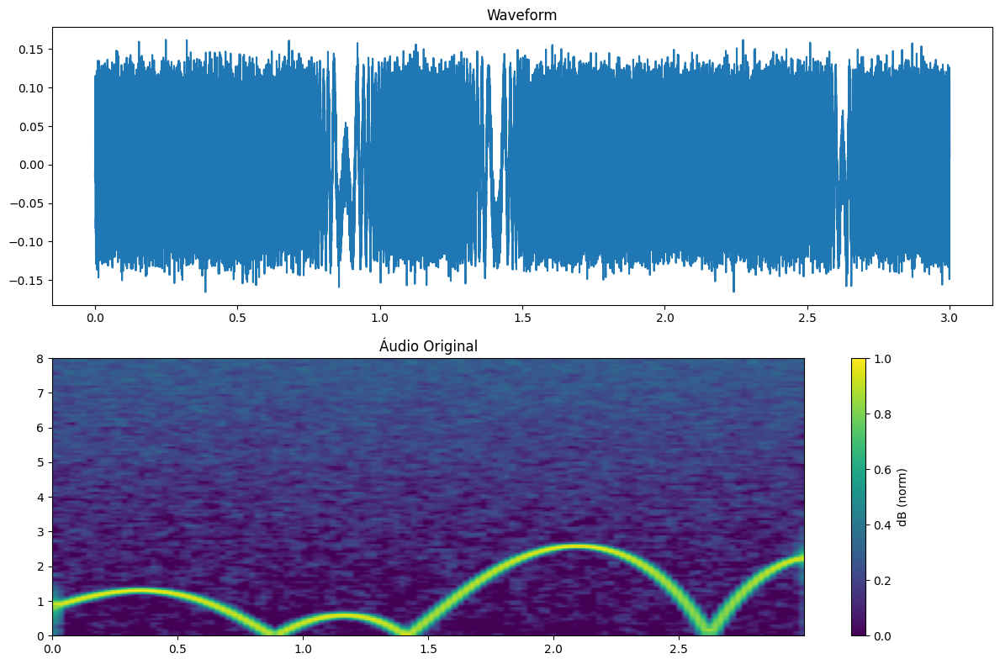

In [75]:
# Transforming audio to espectrograms
class AudioProcessor(nn.Module):
    """Audio processor for converting between waveform and spectrogram Mel"""
    def __init__(self, sr=22050, n_fft=2048, hop_length=512, n_mels=128, fmax=8000):
        super().__init__()
        self.sr = sr
        self.n_fft = n_fft
        self.hop_length = hop_length
        self.n_mels = n_mels
        self.fmax = fmax 

        # Submodules
        self.mel_spectrogram = T.MelSpectrogram(
            sample_rate=sr, n_fft=n_fft, hop_length=hop_length, 
            n_mels=n_mels, f_max=fmax
        )
        self.inverse_mel_scale = T.InverseMelScale(
            n_stft=n_fft // 2 + 1, n_mels=n_mels, 
            sample_rate=sr, f_max=fmax
        )
        self.griffin_lim = T.GriffinLim(
            n_fft=n_fft, hop_length=hop_length, n_iter=32
        )

    def audio_to_mel(self, audio):
        # Guarantee (batch, channel, samples) and move to the MelSpectrogram device.
        if audio.ndim == 1: audio = audio.unsqueeze(0).unsqueeze(0)
        if audio.ndim == 2: audio = audio.unsqueeze(0)
        
        # Synchronizes the audio device with the internal transformation device
        device = self.mel_spectrogram.spectrogram.window.device
        audio = audio.to(device)
            
        mel_spec = self.mel_spectrogram(audio)
        mel_spec_db = torchaudio.functional.amplitude_to_DB(
            mel_spec, multiplier=20, amin=1e-10, db_multiplier=0, top_db=80
        )
        return self._normalize_mel(mel_spec_db)

    def _normalize_mel(self, mel_spec_db):
        """Normalizes Mel spectrogram"""
        # reshape is used instead of view to avoid the RuntimeError for non-contiguous memory
        # The min and max are found by flattening the frequency and time dimensions (dim 2 and 3)
        # The spatial dimensions are reduced to find the min/max, for example, of the batch
        min_v = mel_spec_db.reshape(mel_spec_db.size(0), -1).min(dim=1)[0]
        max_v = mel_spec_db.reshape(mel_spec_db.size(0), -1).max(dim=1)[0]
        
        # Adjust the format to allow broadcasting (member-by-member division).
        min_v = min_v.reshape(-1, 1, 1, 1)
        max_v = max_v.reshape(-1, 1, 1, 1)
        
        return (mel_spec_db - min_v) / (max_v - min_v + 1e-8)

    def visualize_spectrogram(self, audio, title="Mel spectrogram"):
        # Process the Mel
        mel_spec = self.audio_to_mel(audio)
        
        # Move to CPU for viewing only
        audio_np = audio.squeeze().cpu().numpy()
        mel_spec_np = mel_spec.squeeze().cpu().numpy()
        
        fig, axes = plt.subplots(2, 1, figsize=(12, 8))
        time = np.arange(len(audio_np)) / self.sr
        axes[0].plot(time, audio_np)
        axes[0].set_title("Waveform")
        
        img = axes[1].imshow(mel_spec_np, aspect='auto', origin='lower',
                            extent=[0, time[-1], 0, self.fmax/1000])
        axes[1].set_title(title)
        plt.colorbar(img, ax=axes[1], label='dB (norm)')
        plt.tight_layout()
        plt.show()
    def _denormalize_mel(self, mel_spec_normalized, original_min=-80, original_max=0):
        """Denormalize Mel spectrogram from [0, 1] to dB"""
        return mel_spec_normalized * (original_max - original_min) + original_min

    def mel_to_audio(self, mel_spec_norm):
        """Converts normalized Mel spectrogram back to waveform"""
        # 1. Make sure you are on the correct device
        device = self.inverse_mel_scale.fb.device
        mel_spec_norm = mel_spec_norm.to(device)
        
        # 2. Denormalize to dB scale
        mel_spec_db = self._denormalize_mel(mel_spec_norm)
        
        # 3. Convert from dB to amplitude
        mel_spec = torchaudio.functional.DB_to_amplitude(
            mel_spec_db, 
            ref=1.0, 
            power=0.5
        )
        
        # 4. Convert Mel scale to linear (STFT)
        linear_spec = self.inverse_mel_scale(mel_spec)
        
        # 5. Griffin-Lim algorithm to reconstruct the phase and convert to audio.
        audio = self.griffin_lim(linear_spec)
        
        return audio


# Initialize processor and move to device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio_processor = AudioProcessor(sr=22050).to(device)

# Test with a sample
# If test_batch has shape [16, 1, 66150], test_audio will be [1, 66150]
test_audio = test_batch[0] 
print(f"Áudio de teste: {test_audio.shape}")

# Convert to Mel spectrogram
mel_spec = audio_processor.audio_to_mel(test_audio)
print(f"Mel spectrogram: {mel_spec.shape}")

# View
audio_processor.visualize_spectrogram(test_audio, title="Áudio Original")

## 4. VAE implementation for audio

VAE (Variational Autoencoder) is suitable for audio because:
- It learns a continuous latency distribution;
- It allows the generation of new samples;
- It is stable for training.

In [76]:
# VAE Implementation for Mel Spectrograms
class AudioVAE(nn.Module):
    """Variational Autoencoder for Mel spectrograms"""
    def __init__(self, input_channels=1, latent_dim=256, hidden_dims=[32, 64, 128, 256]):
        super(AudioVAE, self).__init__()
        
        self.latent_dim = latent_dim
        self.input_channels = input_channels
        self.hidden_dims = hidden_dims
        
        # Encoder
        encoder_layers = []
        in_channels = input_channels
        for h_dim in hidden_dims:
            encoder_layers.extend([
                nn.Conv2d(in_channels, h_dim, kernel_size=3, stride=2, padding=1),
                nn.BatchNorm2d(h_dim),
                nn.LeakyReLU(0.2)
            ])
            in_channels = h_dim
        
        self.encoder = nn.Sequential(*encoder_layers)
        
        # --- DYNAMIC SHAPE CORRECTION ---
        with torch.no_grad():
            # It uses 128x130, which is the standard for audio of 3s at 22050Hz
            dummy_input = torch.randn(1, input_channels, 128, 130)
            dummy_output = self.encoder(dummy_input)
            # Save the shape (C, H, W) for the Decoder to use later
            self.shape_before_flatten = dummy_output.shape[1:] 
            # Calculates the total features (C * H * W)
            self.encoder_output_size = dummy_output.view(1, -1).size(1)

        # Linear Layers
        self.fc_mu = nn.Linear(self.encoder_output_size, latent_dim)
        self.fc_var = nn.Linear(self.encoder_output_size, latent_dim)
        
        # Decoder
        self.decoder_input = nn.Linear(latent_dim, self.encoder_output_size)
        
        decoder_layers = []
        hidden_dims_rev = list(reversed(hidden_dims))
        
        # Intermediate layers
        for i in range(len(hidden_dims_rev) - 1):
            decoder_layers.extend([
                nn.ConvTranspose2d(hidden_dims_rev[i], hidden_dims_rev[i + 1],
                                  kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.BatchNorm2d(hidden_dims_rev[i + 1]),
                nn.LeakyReLU(0.2)
            ])
        
        # FINAL LAYER: Fine-tuning output padding to avoid errors
        # Excessive output padding is reduced or adjusted as needed.
        decoder_layers.extend([
            nn.ConvTranspose2d(hidden_dims_rev[-1], hidden_dims_rev[-1],
                              kernel_size=3, stride=2, padding=1, output_padding=(1, 1)), # Ajuste aqui
            nn.BatchNorm2d(hidden_dims_rev[-1]),
            nn.LeakyReLU(0.2),
            nn.Conv2d(hidden_dims_rev[-1], input_channels, kernel_size=3, padding=1),
            nn.Sigmoid() 
        ])
        
        self.decoder = nn.Sequential(*decoder_layers)
        
    def encode(self, x):
        result = self.encoder(x)
        result = torch.flatten(result, start_dim=1)
        mu = self.fc_mu(result)
        log_var = self.fc_var(result)
        return mu, log_var
    
    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def decode(self, z):
        """Decoder: z -> x_recon with dynamic size adjustment"""
        # 1. Passes through the initial linear layer of the decoder
        result = self.decoder_input(z)
        
        # 2. Reshapes to 3D format (C, H, W)
        result = result.view(-1, *self.shape_before_flatten)
        
        # 3. It passes through the transposed convolution layers
        result = self.decoder(result)
        
        result = torch.nn.functional.interpolate(
            result, 
            size=(128, 130), 
            mode='bilinear', 
            align_corners=False
        )
        
        return result

    
    def forward(self, x):
        """Forward pass complete"""
        mu, log_var = self.encode(x)
        z = self.reparameterize(mu, log_var)
        x_recon = self.decode(z)
        
        # if the original x differs by 1 pixel, we adjust the recon
        if x_recon.shape != x.shape:
            x_recon = torch.nn.functional.interpolate(x_recon, size=x.shape[2:], mode='bilinear', align_corners=False)
            
        return x_recon, mu, log_var

    def generate(self, num_samples, device):
        """Generates new samples from latent space"""
        z = torch.randn(num_samples, self.latent_dim).to(device)
        return self.decode(z)

In [77]:
# Loss functions for VAE
def vae_loss(recon_x, x, mu, log_var, beta=1.0):
    """
    Loss of VAE = Reconstruction Loss + β * KL Divergence

    Args:
        recon_x: Reconstruction
        x: Original input
        mu: Mean of the latent space
        log_var: Log variance of the latent space
        beta: Weight of the KL divergence (for β-VAE)
    """
    # Reconstruction loss (MSE)
    recon_loss = F.mse_loss(recon_x, x, reduction='sum') / x.size(0)
    
    # KL divergence
    kl_loss = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp()) / x.size(0)
    
    # Loss total
    total_loss = recon_loss + beta * kl_loss
    
    return total_loss, recon_loss, kl_loss

In [78]:
# Initialize model
print("Initialize AudioVAE...")
latent_dim = 128
model = AudioVAE(input_channels=1, latent_dim=latent_dim).to(device)

def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"Model parameters: {count_parameters(model):,}")
print(model)

# mel_spec should already be [Batch, 1, 128, Tempo] coming from the previous cell
test_mel = mel_spec.to(device) 

# if you still have 3 dimensions, add batch
if test_mel.ndim == 3:
    test_mel = test_mel.unsqueeze(0)
# If you have 5 dimensions, remove the extra dimension.
elif test_mel.ndim == 5:
    test_mel = test_mel.squeeze(0)

print(f"Final shape sent to the model: {test_mel.shape}")

# Forward pass
recon, mu, log_var = model(test_mel)

print(f"Input shape: {test_mel.shape}")
print(f"Reconstruction shape: {recon.shape}")
print(f"Latent mu shape: {mu.shape}")

Initialize AudioVAE...
Model parameters: 7,882,721
AudioVAE(
  (encoder): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2)
    (9): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2)
  )
  (fc_mu): Linear(in_features=18432, out_features=128, bias=True)
  (fc_var): Linear(in_feat

## 5.  Training Pipeline

In [79]:
# Utility functions for training
class VAETrainer:
    """Class for managing VAE training"""
    def __init__(self, model, audio_processor, device, lr=1e-4, beta=1.0):
        self.model = model
        self.audio_processor = audio_processor
        self.device = device
        self.beta = beta

        # Optimizer
        self.optimizer = optim.Adam(model.parameters(), lr=lr)
        
        # Monitoring lists
        self.train_losses = []
        self.recon_losses = []
        self.kl_losses = []
        self.val_losses = []
        
    def train_epoch(self, train_loader, epoch):
        """Train for a season"""
        self.model.train()
        total_loss = 0
        total_recon = 0
        total_kl = 0
        
        pbar = tqdm(train_loader, desc=f"Epoch {epoch}")
        for batch_idx, audio_batch in enumerate(pbar):
            audio_batch = audio_batch.to(self.device)
            
            # Convert audio to Mel spectrogram
            mel_batch = self.audio_processor.audio_to_mel(audio_batch)
            
            # Forward pass
            recon_batch, mu, log_var = self.model(mel_batch)
            
            # Calculate loss
            loss, recon_loss, kl_loss = vae_loss(
                recon_batch, mel_batch, mu, log_var, self.beta
            )
            
            # Backward pass
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            
            # Accumulate statistics
            total_loss += loss.item()
            total_recon += recon_loss.item()
            total_kl += kl_loss.item()
            
            # Update progress bar
            pbar.set_postfix({
                'Loss': f"{loss.item():.4f}",
                'Recon': f"{recon_loss.item():.4f}",
                'KL': f"{kl_loss.item():.4f}"
            })
            
            # Save every 10 batches for monitoring
            if batch_idx % 10 == 0:
                self.train_losses.append(loss.item())
                self.recon_losses.append(recon_loss.item())
                self.kl_losses.append(kl_loss.item())
        
        # Calculate averages
        avg_loss = total_loss / len(train_loader)
        avg_recon = total_recon / len(train_loader)
        avg_kl = total_kl / len(train_loader)
        
        return avg_loss, avg_recon, avg_kl
    
    def save_checkpoint(self, epoch, path='audio_checkpoints/vae_checkpoint.pth'):
        """Save model checkpoint"""
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
            'train_losses': self.train_losses,
            'recon_losses': self.recon_losses,
            'kl_losses': self.kl_losses,
            'beta': self.beta
        }
        
        torch.save(checkpoint, path)
        print(f"Checkpoint saved: {path}")
    
    def load_checkpoint(self, path='audio_checkpoints/vae_checkpoint.pth'):
        """Load model checkpoint"""
        if os.path.exists(path):
            checkpoint = torch.load(path, map_location=self.device)
            self.model.load_state_dict(checkpoint['model_state_dict'])
            self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            self.train_losses = checkpoint.get('train_losses', [])
            self.recon_losses = checkpoint.get('recon_losses', [])
            self.kl_losses = checkpoint.get('kl_losses', [])
            self.beta = checkpoint.get('beta', 1.0)
            
            print(f"Checkpoint loaded: {path}")
            return checkpoint['epoch']
        else:
            print(f"Checkpoint not found: {path}")
            return 0
    
    def reconstruct_audio(self, audio_sample, save_path=None):
        """Reconstructs an audio file and visualizes the results"""
        self.model.eval()
        
        with torch.no_grad():
            # Convert to Mel spectrogram
            mel_original = self.audio_processor.audio_to_mel(audio_sample.unsqueeze(0).to(device))
            
            # Rebuild
            mel_recon, mu, log_var = self.model(mel_original)
            
            # Convert back to audio
            audio_recon = self.audio_processor.mel_to_audio(mel_recon)
            
            # Visualize
            self._visualize_reconstruction(
                audio_sample.squeeze().cpu().numpy(),
                audio_recon.squeeze().cpu().numpy(),
                mel_original.squeeze().cpu().numpy(),
                mel_recon.squeeze().cpu().numpy()
            )
            
            # Save if specified
            if save_path:
                sf.write(save_path, audio_recon.squeeze().cpu().numpy(), 
                        self.audio_processor.sr)
                print(f"Reconstructed audio saved: {save_path}")
        
        self.model.train()
        return audio_recon, mel_recon
    
    def _visualize_reconstruction(self, audio_orig, audio_recon, mel_orig, mel_recon):
        """Visualize a comparison between the original and the reconstructed version with size adjustment"""
        fig, axes = plt.subplots(2, 2, figsize=(15, 10))

        # Ensures that the reconstructed audio is the same size as the original for the plot
        if len(audio_recon) > len(audio_orig):
            audio_recon = audio_recon[:len(audio_orig)]
        elif len(audio_recon) < len(audio_orig):
            audio_recon = np.pad(audio_recon, (0, len(audio_orig) - len(audio_recon)))

        # Waveforms
        time = np.arange(len(audio_orig)) / self.audio_processor.sr
        
        axes[0, 0].plot(time, audio_orig)
        axes[0, 0].set_title('Waveform Original')
        axes[0, 0].set_xlabel('Time (s)')
        axes[0, 0].set_ylabel('Amplitude')
        axes[0, 0].grid(True)
        
        # Time and audio_recon will have the same size (66150)
        axes[0, 1].plot(time, audio_recon)
        axes[0, 1].set_title('Waveform Reconstructed')
        axes[0, 1].set_xlabel('Time (s)')
        axes[0, 1].set_ylabel('Amplitude')
        axes[0, 1].grid(True)
        
        # Spectrograms
        extent = [0, time[-1], 0, self.audio_processor.fmax/1000]
        
        im1 = axes[1, 0].imshow(mel_orig, aspect='auto', origin='lower', extent=extent)
        axes[1, 0].set_title('Spectrogram Mel Original')
        axes[1, 0].set_xlabel('Time (s)')
        axes[1, 0].set_ylabel('Frequency (kHz)')
        plt.colorbar(im1, ax=axes[1, 0])
        
        im2 = axes[1, 1].imshow(mel_recon, aspect='auto', origin='lower', extent=extent)
        axes[1, 1].set_title('Spectrogram Mel Reconstructed')
        axes[1, 1].set_xlabel('Time (s)')
        axes[1, 1].set_ylabel('Frequency (kHz)')
        plt.colorbar(im2, ax=axes[1, 1])
        
        plt.tight_layout()
        os.makedirs('audio_results', exist_ok=True) # Ensures that the folder exists
        plt.savefig('audio_results/reconstruction_comparison.png', dpi=150)
        plt.show()

In [80]:
# Configure training
# Initialize trainer
trainer = VAETrainer(
    model=model,
    audio_processor=audio_processor,
    device=device,
    lr=1e-4,
    beta=1.0
)

# Load checkpoint if exists
start_epoch = trainer.load_checkpoint()

# Epochs number
num_epochs = 100

Checkpoint not found: audio_checkpoints/vae_checkpoint.pth


Starting AudioVAE training...
Epochs: 100
Batch size: 16
Latent dim: 128
Device: cuda
Epoch 1/100


Epoch 1: 100%|██████████| 1/1 [00:00<00:00,  2.69it/s, Loss=2348.7832, Recon=2331.3923, KL=17.3908]


Summary of epochs 1:
Loss total: 2348.7832
Loss reconstruction: 2331.3923
Loss KL: 17.3908
Epoch 2/100


Epoch 2: 100%|██████████| 1/1 [00:00<00:00,  4.04it/s, Loss=2316.0161, Recon=2294.3894, KL=21.6267]


Summary of epochs 2:
Loss total: 2316.0161
Loss reconstruction: 2294.3894
Loss KL: 21.6267
Epoch 3/100


Epoch 3: 100%|██████████| 1/1 [00:00<00:00,  4.04it/s, Loss=2281.4592, Recon=2263.2571, KL=18.2021]


Summary of epochs 3:
Loss total: 2281.4592
Loss reconstruction: 2263.2571
Loss KL: 18.2021
Epoch 4/100


Epoch 4: 100%|██████████| 1/1 [00:00<00:00,  4.13it/s, Loss=2247.1387, Recon=2232.0603, KL=15.0785]


Summary of epochs 4:
Loss total: 2247.1387
Loss reconstruction: 2232.0603
Loss KL: 15.0785
Epoch 5/100


Epoch 5: 100%|██████████| 1/1 [00:00<00:00,  4.07it/s, Loss=2216.0066, Recon=2202.7141, KL=13.2925]


Summary of epochs 5:
Loss total: 2216.0066
Loss reconstruction: 2202.7141
Loss KL: 13.2925
Checkpoint saved: audio_checkpoints/vae_epoch_5.pth
Demonstrate reconstruction...


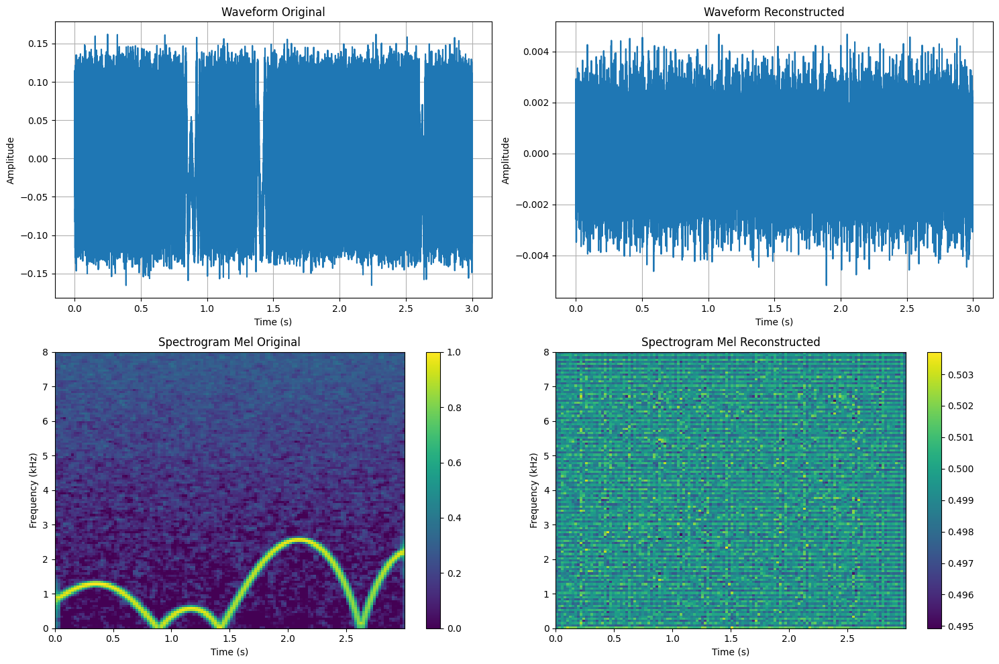

Reconstructed audio saved: reconstructed_audio/epoch_5.wav
Playing original audio...


Playing reconstructed audio...


Epoch 6/100


Epoch 6: 100%|██████████| 1/1 [00:00<00:00,  2.17it/s, Loss=2184.1521, Recon=2171.1157, KL=13.0363]


Summary of epochs 6:
Loss total: 2184.1521
Loss reconstruction: 2171.1157
Loss KL: 13.0363
Epoch 7/100


Epoch 7: 100%|██████████| 1/1 [00:00<00:00,  3.67it/s, Loss=2155.7197, Recon=2142.6648, KL=13.0549]


Summary of epochs 7:
Loss total: 2155.7197
Loss reconstruction: 2142.6648
Loss KL: 13.0549
Epoch 8/100


Epoch 8: 100%|██████████| 1/1 [00:00<00:00,  3.78it/s, Loss=2122.7249, Recon=2109.7781, KL=12.9467]


Summary of epochs 8:
Loss total: 2122.7249
Loss reconstruction: 2109.7781
Loss KL: 12.9467
Epoch 9/100


Epoch 9: 100%|██████████| 1/1 [00:00<00:00,  4.10it/s, Loss=2093.1226, Recon=2080.3689, KL=12.7537]


Summary of epochs 9:
Loss total: 2093.1226
Loss reconstruction: 2080.3689
Loss KL: 12.7537
Epoch 10/100


Epoch 10: 100%|██████████| 1/1 [00:00<00:00,  4.10it/s, Loss=2062.1306, Recon=2049.0730, KL=13.0576]


Summary of epochs 10:
Loss total: 2062.1306
Loss reconstruction: 2049.0730
Loss KL: 13.0576
Checkpoint saved: audio_checkpoints/vae_epoch_10.pth
Demonstrate reconstruction...


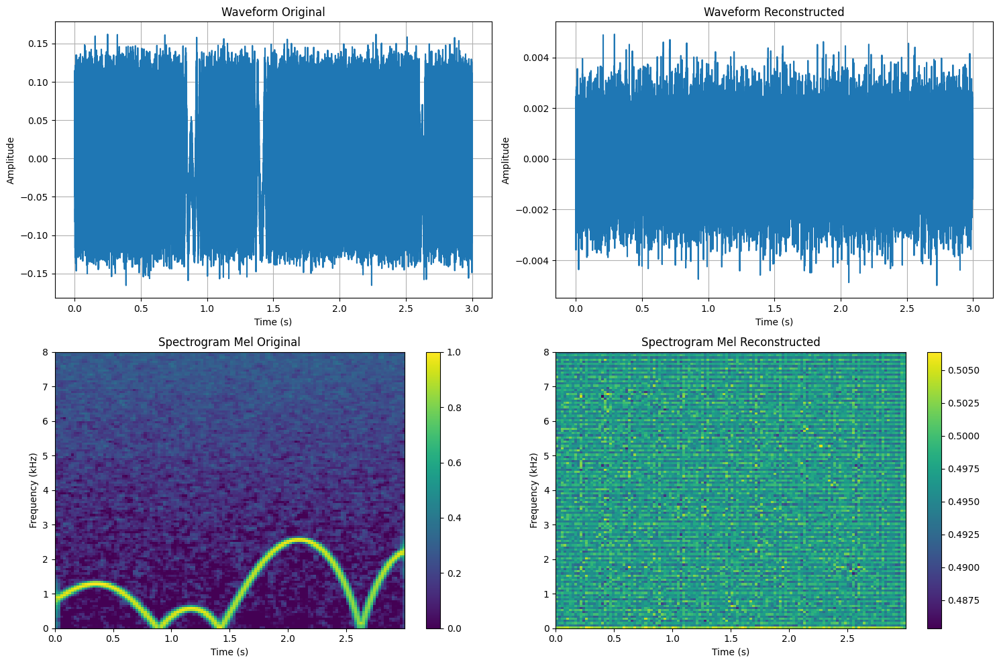

Reconstructed audio saved: reconstructed_audio/epoch_10.wav
Playing original audio...


Playing reconstructed audio...


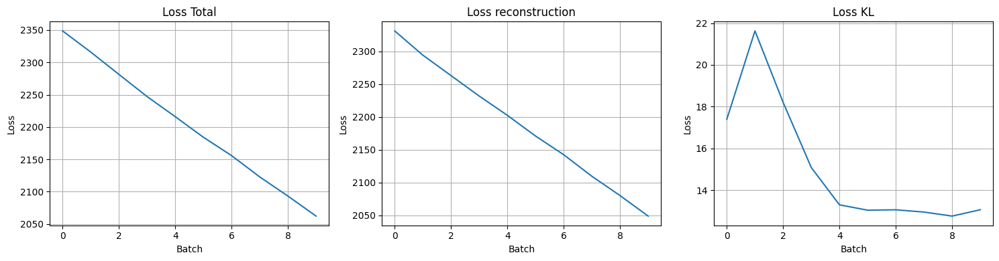

Epoch 11/100


Epoch 11: 100%|██████████| 1/1 [00:00<00:00,  2.12it/s, Loss=2034.4614, Recon=2021.3453, KL=13.1161]


Summary of epochs 11:
Loss total: 2034.4614
Loss reconstruction: 2021.3453
Loss KL: 13.1161
Epoch 12/100


Epoch 12: 100%|██████████| 1/1 [00:00<00:00,  4.08it/s, Loss=2005.0687, Recon=1992.0071, KL=13.0617]


Summary of epochs 12:
Loss total: 2005.0687
Loss reconstruction: 1992.0071
Loss KL: 13.0617
Epoch 13/100


Epoch 13: 100%|██████████| 1/1 [00:00<00:00,  4.13it/s, Loss=1979.9586, Recon=1967.3158, KL=12.6428]


Summary of epochs 13:
Loss total: 1979.9586
Loss reconstruction: 1967.3158
Loss KL: 12.6428
Epoch 14/100


Epoch 14: 100%|██████████| 1/1 [00:00<00:00,  3.89it/s, Loss=1951.3085, Recon=1938.6250, KL=12.6835]


Summary of epochs 14:
Loss total: 1951.3085
Loss reconstruction: 1938.6250
Loss KL: 12.6835
Epoch 15/100


Epoch 15: 100%|██████████| 1/1 [00:00<00:00,  4.13it/s, Loss=1922.0363, Recon=1908.9945, KL=13.0418]


Summary of epochs 15:
Loss total: 1922.0363
Loss reconstruction: 1908.9945
Loss KL: 13.0418
Checkpoint saved: audio_checkpoints/vae_epoch_15.pth
Demonstrate reconstruction...


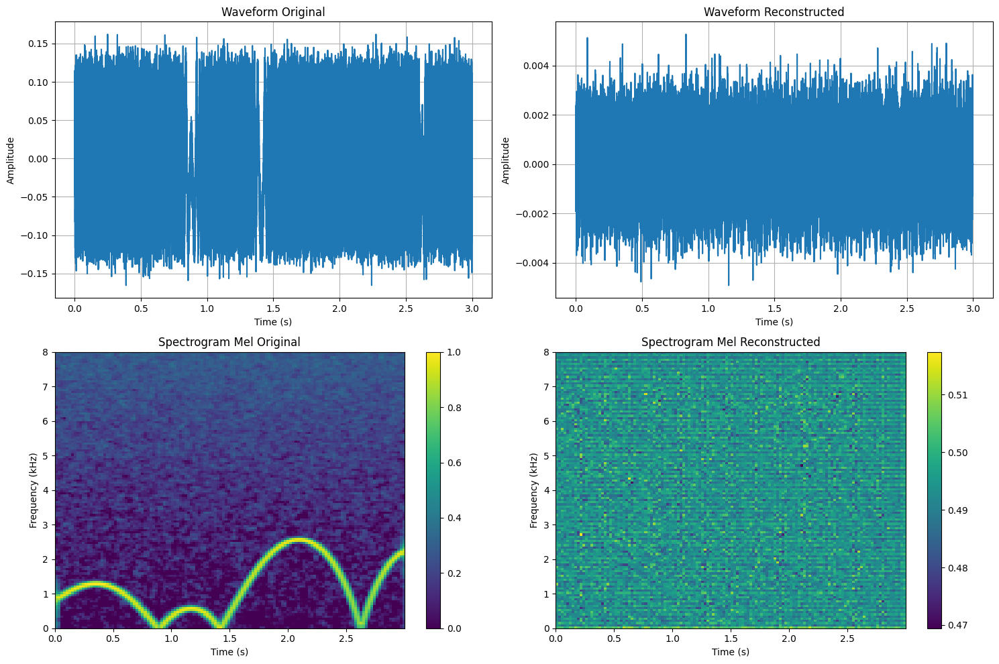

Reconstructed audio saved: reconstructed_audio/epoch_15.wav
Playing original audio...


Playing reconstructed audio...


Epoch 16/100


Epoch 16: 100%|██████████| 1/1 [00:00<00:00,  2.03it/s, Loss=1893.4302, Recon=1878.9758, KL=14.4544]


Summary of epochs 16:
Loss total: 1893.4302
Loss reconstruction: 1878.9758
Loss KL: 14.4544
Epoch 17/100


Epoch 17: 100%|██████████| 1/1 [00:00<00:00,  4.09it/s, Loss=1867.5028, Recon=1851.1711, KL=16.3317]


Summary of epochs 17:
Loss total: 1867.5028
Loss reconstruction: 1851.1711
Loss KL: 16.3317
Epoch 18/100


Epoch 18: 100%|██████████| 1/1 [00:00<00:00,  4.10it/s, Loss=1840.5619, Recon=1823.1044, KL=17.4575]


Summary of epochs 18:
Loss total: 1840.5619
Loss reconstruction: 1823.1044
Loss KL: 17.4575
Epoch 19/100


Epoch 19: 100%|██████████| 1/1 [00:00<00:00,  4.02it/s, Loss=1812.8264, Recon=1795.2621, KL=17.5644]


Summary of epochs 19:
Loss total: 1812.8264
Loss reconstruction: 1795.2621
Loss KL: 17.5644
Epoch 20/100


Epoch 20: 100%|██████████| 1/1 [00:00<00:00,  3.99it/s, Loss=1787.2211, Recon=1769.8918, KL=17.3292]


Summary of epochs 20:
Loss total: 1787.2211
Loss reconstruction: 1769.8918
Loss KL: 17.3292
Checkpoint saved: audio_checkpoints/vae_epoch_20.pth
Demonstrate reconstruction...


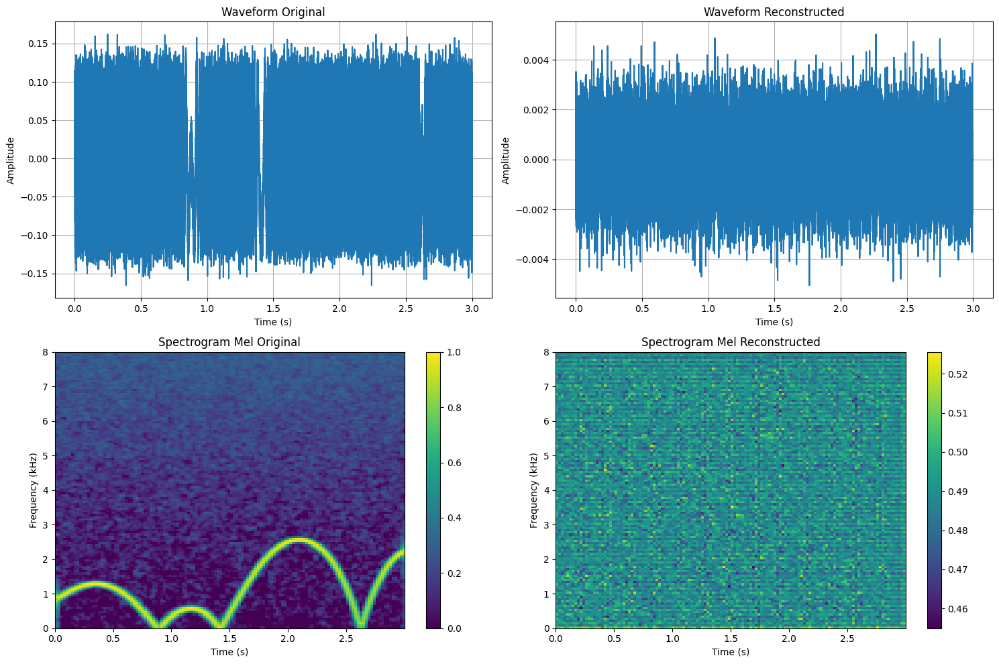

Reconstructed audio saved: reconstructed_audio/epoch_20.wav
Playing original audio...


Playing reconstructed audio...


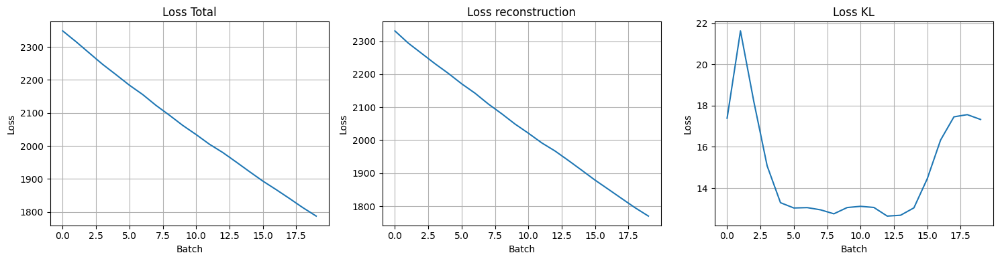

Epoch 21/100


Epoch 21: 100%|██████████| 1/1 [00:00<00:00,  2.08it/s, Loss=1760.3522, Recon=1743.0989, KL=17.2533]


Summary of epochs 21:
Loss total: 1760.3522
Loss reconstruction: 1743.0989
Loss KL: 17.2533
Epoch 22/100


Epoch 22: 100%|██████████| 1/1 [00:00<00:00,  3.98it/s, Loss=1734.5106, Recon=1716.8059, KL=17.7047]


Summary of epochs 22:
Loss total: 1734.5106
Loss reconstruction: 1716.8059
Loss KL: 17.7047
Epoch 23/100


Epoch 23: 100%|██████████| 1/1 [00:00<00:00,  3.86it/s, Loss=1707.5060, Recon=1688.9462, KL=18.5598]


Summary of epochs 23:
Loss total: 1707.5060
Loss reconstruction: 1688.9462
Loss KL: 18.5598
Epoch 24/100


Epoch 24: 100%|██████████| 1/1 [00:00<00:00,  3.51it/s, Loss=1678.1184, Recon=1659.4229, KL=18.6955]


Summary of epochs 24:
Loss total: 1678.1184
Loss reconstruction: 1659.4229
Loss KL: 18.6955
Epoch 25/100


Epoch 25: 100%|██████████| 1/1 [00:00<00:00,  3.53it/s, Loss=1655.8474, Recon=1638.2695, KL=17.5779]


Summary of epochs 25:
Loss total: 1655.8474
Loss reconstruction: 1638.2695
Loss KL: 17.5779
Checkpoint saved: audio_checkpoints/vae_epoch_25.pth
Demonstrate reconstruction...


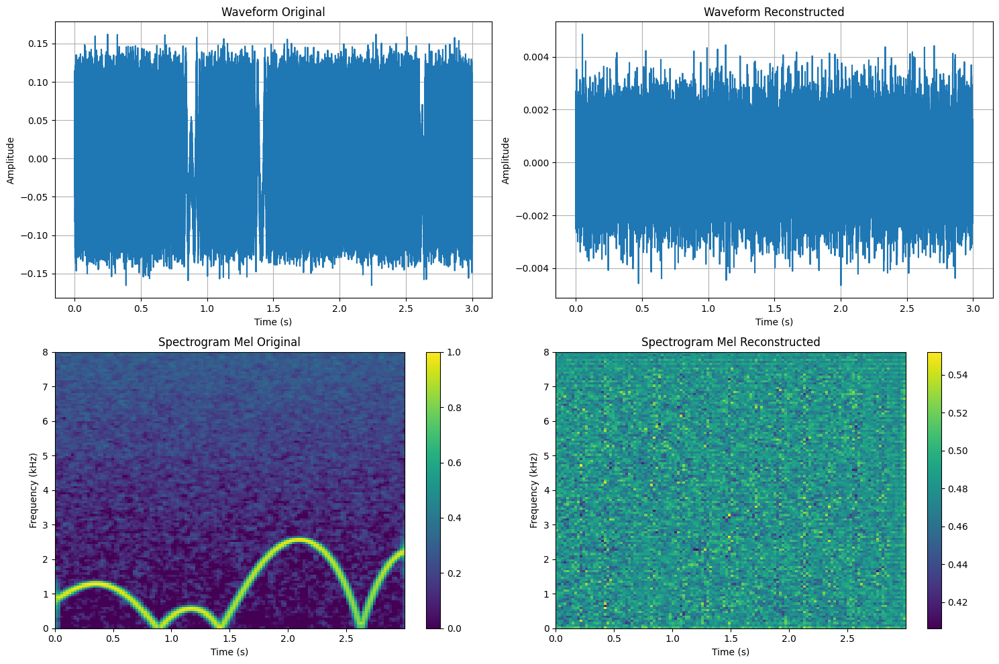

Reconstructed audio saved: reconstructed_audio/epoch_25.wav
Playing original audio...


Playing reconstructed audio...


Epoch 26/100


Epoch 26: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s, Loss=1628.2451, Recon=1611.3046, KL=16.9406]


Summary of epochs 26:
Loss total: 1628.2451
Loss reconstruction: 1611.3046
Loss KL: 16.9406
Epoch 27/100


Epoch 27: 100%|██████████| 1/1 [00:00<00:00,  3.97it/s, Loss=1608.1455, Recon=1590.9081, KL=17.2374]


Summary of epochs 27:
Loss total: 1608.1455
Loss reconstruction: 1590.9081
Loss KL: 17.2374
Epoch 28/100


Epoch 28: 100%|██████████| 1/1 [00:00<00:00,  3.86it/s, Loss=1578.6405, Recon=1559.7822, KL=18.8583]


Summary of epochs 28:
Loss total: 1578.6405
Loss reconstruction: 1559.7822
Loss KL: 18.8583
Epoch 29/100


Epoch 29: 100%|██████████| 1/1 [00:00<00:00,  3.83it/s, Loss=1553.9735, Recon=1533.2411, KL=20.7324]


Summary of epochs 29:
Loss total: 1553.9735
Loss reconstruction: 1533.2411
Loss KL: 20.7324
Epoch 30/100


Epoch 30: 100%|██████████| 1/1 [00:00<00:00,  3.50it/s, Loss=1532.9215, Recon=1511.0596, KL=21.8619]


Summary of epochs 30:
Loss total: 1532.9215
Loss reconstruction: 1511.0596
Loss KL: 21.8619
Checkpoint saved: audio_checkpoints/vae_epoch_30.pth
Demonstrate reconstruction...


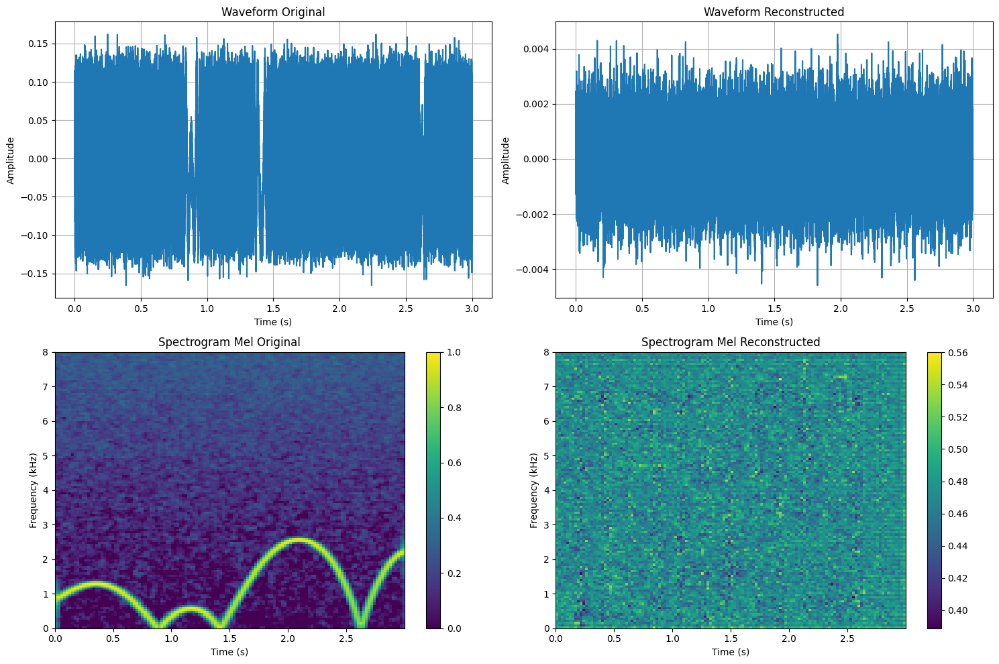

Reconstructed audio saved: reconstructed_audio/epoch_30.wav
Playing original audio...


Playing reconstructed audio...


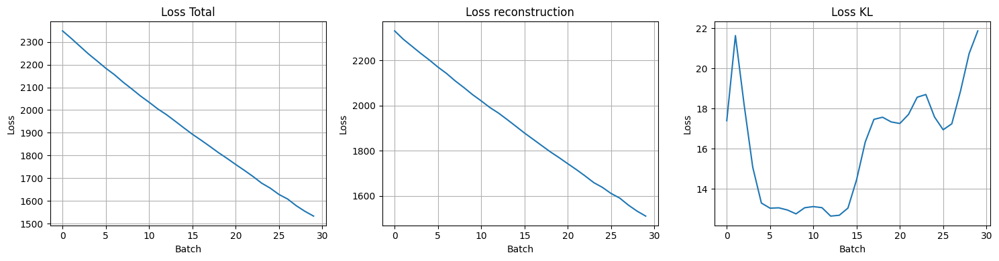

Epoch 31/100


Epoch 31: 100%|██████████| 1/1 [00:00<00:00,  2.38it/s, Loss=1507.0602, Recon=1484.0522, KL=23.0080]


Summary of epochs 31:
Loss total: 1507.0602
Loss reconstruction: 1484.0522
Loss KL: 23.0080
Epoch 32/100


Epoch 32: 100%|██████████| 1/1 [00:00<00:00,  3.94it/s, Loss=1485.7432, Recon=1462.4365, KL=23.3066]


Summary of epochs 32:
Loss total: 1485.7432
Loss reconstruction: 1462.4365
Loss KL: 23.3066
Epoch 33/100


Epoch 33: 100%|██████████| 1/1 [00:00<00:00,  4.04it/s, Loss=1457.4268, Recon=1433.6753, KL=23.7515]


Summary of epochs 33:
Loss total: 1457.4268
Loss reconstruction: 1433.6753
Loss KL: 23.7515
Epoch 34/100


Epoch 34: 100%|██████████| 1/1 [00:00<00:00,  4.02it/s, Loss=1437.1450, Recon=1413.5491, KL=23.5959]


Summary of epochs 34:
Loss total: 1437.1450
Loss reconstruction: 1413.5491
Loss KL: 23.5959
Epoch 35/100


Epoch 35: 100%|██████████| 1/1 [00:00<00:00,  4.11it/s, Loss=1411.8116, Recon=1387.2084, KL=24.6033]


Summary of epochs 35:
Loss total: 1411.8116
Loss reconstruction: 1387.2084
Loss KL: 24.6033
Checkpoint saved: audio_checkpoints/vae_epoch_35.pth
Demonstrate reconstruction...


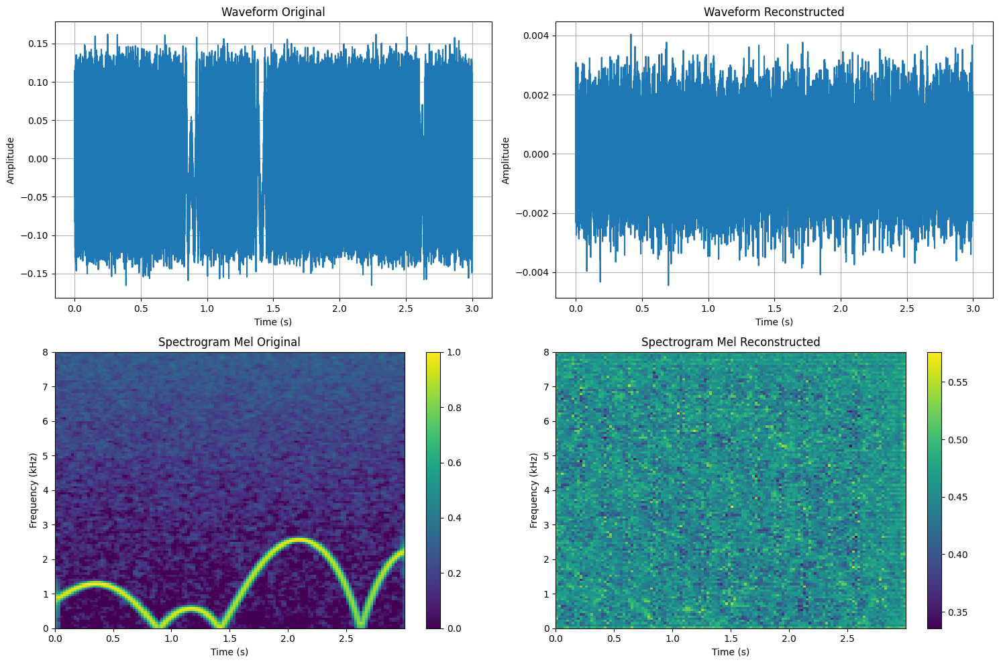

Reconstructed audio saved: reconstructed_audio/epoch_35.wav
Playing original audio...


Playing reconstructed audio...


Epoch 36/100


Epoch 36: 100%|██████████| 1/1 [00:00<00:00,  2.34it/s, Loss=1387.4054, Recon=1362.4670, KL=24.9384]


Summary of epochs 36:
Loss total: 1387.4054
Loss reconstruction: 1362.4670
Loss KL: 24.9384
Epoch 37/100


Epoch 37: 100%|██████████| 1/1 [00:00<00:00,  4.08it/s, Loss=1365.9784, Recon=1341.0898, KL=24.8886]


Summary of epochs 37:
Loss total: 1365.9784
Loss reconstruction: 1341.0898
Loss KL: 24.8886
Epoch 38/100


Epoch 38: 100%|██████████| 1/1 [00:00<00:00,  3.96it/s, Loss=1339.5049, Recon=1314.4877, KL=25.0172]


Summary of epochs 38:
Loss total: 1339.5049
Loss reconstruction: 1314.4877
Loss KL: 25.0172
Epoch 39/100


Epoch 39: 100%|██████████| 1/1 [00:00<00:00,  4.12it/s, Loss=1321.5308, Recon=1297.0165, KL=24.5143]


Summary of epochs 39:
Loss total: 1321.5308
Loss reconstruction: 1297.0165
Loss KL: 24.5143
Epoch 40/100


Epoch 40: 100%|██████████| 1/1 [00:00<00:00,  3.85it/s, Loss=1298.8022, Recon=1273.4984, KL=25.3038]


Summary of epochs 40:
Loss total: 1298.8022
Loss reconstruction: 1273.4984
Loss KL: 25.3038
Checkpoint saved: audio_checkpoints/vae_epoch_40.pth
Demonstrate reconstruction...


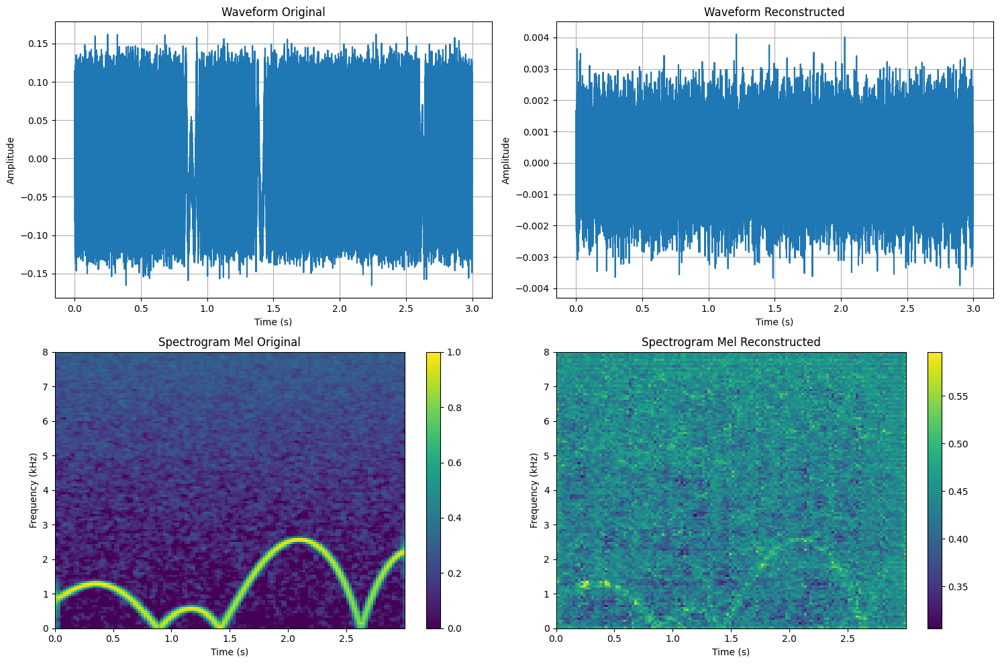

Reconstructed audio saved: reconstructed_audio/epoch_40.wav
Playing original audio...


Playing reconstructed audio...


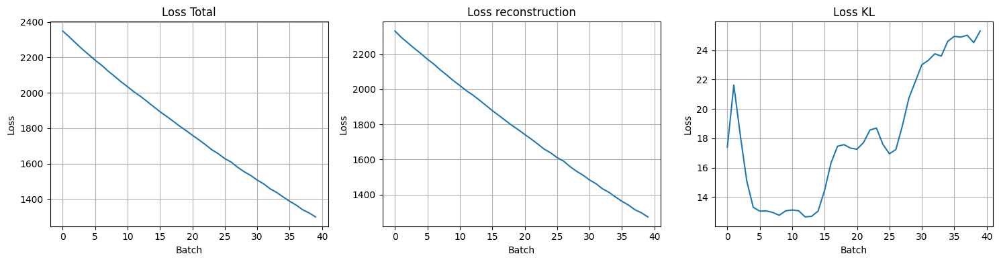

Epoch 41/100


Epoch 41: 100%|██████████| 1/1 [00:00<00:00,  2.14it/s, Loss=1275.5419, Recon=1248.6449, KL=26.8970]


Summary of epochs 41:
Loss total: 1275.5419
Loss reconstruction: 1248.6449
Loss KL: 26.8970
Epoch 42/100


Epoch 42: 100%|██████████| 1/1 [00:00<00:00,  4.11it/s, Loss=1253.2843, Recon=1225.5950, KL=27.6893]


Summary of epochs 42:
Loss total: 1253.2843
Loss reconstruction: 1225.5950
Loss KL: 27.6893
Epoch 43/100


Epoch 43: 100%|██████████| 1/1 [00:00<00:00,  3.77it/s, Loss=1232.5696, Recon=1205.3713, KL=27.1982]


Summary of epochs 43:
Loss total: 1232.5696
Loss reconstruction: 1205.3713
Loss KL: 27.1982
Epoch 44/100


Epoch 44: 100%|██████████| 1/1 [00:00<00:00,  4.01it/s, Loss=1208.1299, Recon=1181.5789, KL=26.5510]


Summary of epochs 44:
Loss total: 1208.1299
Loss reconstruction: 1181.5789
Loss KL: 26.5510
Epoch 45/100


Epoch 45: 100%|██████████| 1/1 [00:00<00:00,  4.02it/s, Loss=1191.0096, Recon=1165.9875, KL=25.0221]


Summary of epochs 45:
Loss total: 1191.0096
Loss reconstruction: 1165.9875
Loss KL: 25.0221
Checkpoint saved: audio_checkpoints/vae_epoch_45.pth
Demonstrate reconstruction...


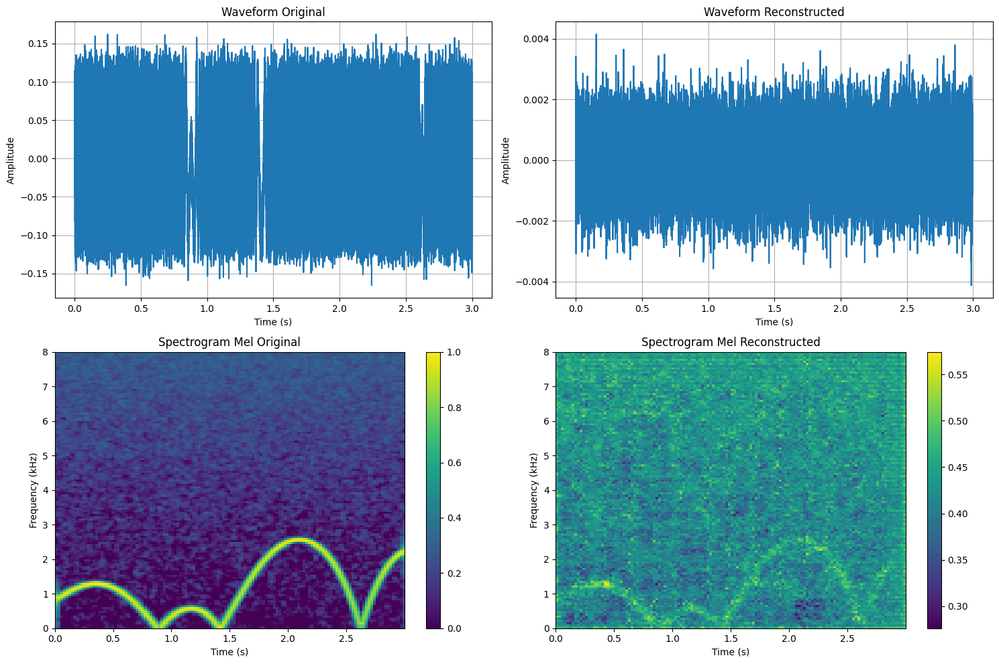

Reconstructed audio saved: reconstructed_audio/epoch_45.wav
Playing original audio...


Playing reconstructed audio...


Epoch 46/100


Epoch 46: 100%|██████████| 1/1 [00:00<00:00,  2.08it/s, Loss=1169.0919, Recon=1143.6301, KL=25.4617]


Summary of epochs 46:
Loss total: 1169.0919
Loss reconstruction: 1143.6301
Loss KL: 25.4617
Epoch 47/100


Epoch 47: 100%|██████████| 1/1 [00:00<00:00,  3.88it/s, Loss=1149.5878, Recon=1122.5702, KL=27.0176]


Summary of epochs 47:
Loss total: 1149.5878
Loss reconstruction: 1122.5702
Loss KL: 27.0176
Epoch 48/100


Epoch 48: 100%|██████████| 1/1 [00:00<00:00,  3.83it/s, Loss=1127.6908, Recon=1099.5800, KL=28.1108]


Summary of epochs 48:
Loss total: 1127.6908
Loss reconstruction: 1099.5800
Loss KL: 28.1108
Epoch 49/100


Epoch 49: 100%|██████████| 1/1 [00:00<00:00,  3.74it/s, Loss=1109.9982, Recon=1082.3182, KL=27.6800]


Summary of epochs 49:
Loss total: 1109.9982
Loss reconstruction: 1082.3182
Loss KL: 27.6800
Epoch 50/100


Epoch 50: 100%|██████████| 1/1 [00:00<00:00,  3.68it/s, Loss=1089.6553, Recon=1063.0896, KL=26.5656]


Summary of epochs 50:
Loss total: 1089.6553
Loss reconstruction: 1063.0896
Loss KL: 26.5656
Checkpoint saved: audio_checkpoints/vae_epoch_50.pth
Demonstrate reconstruction...


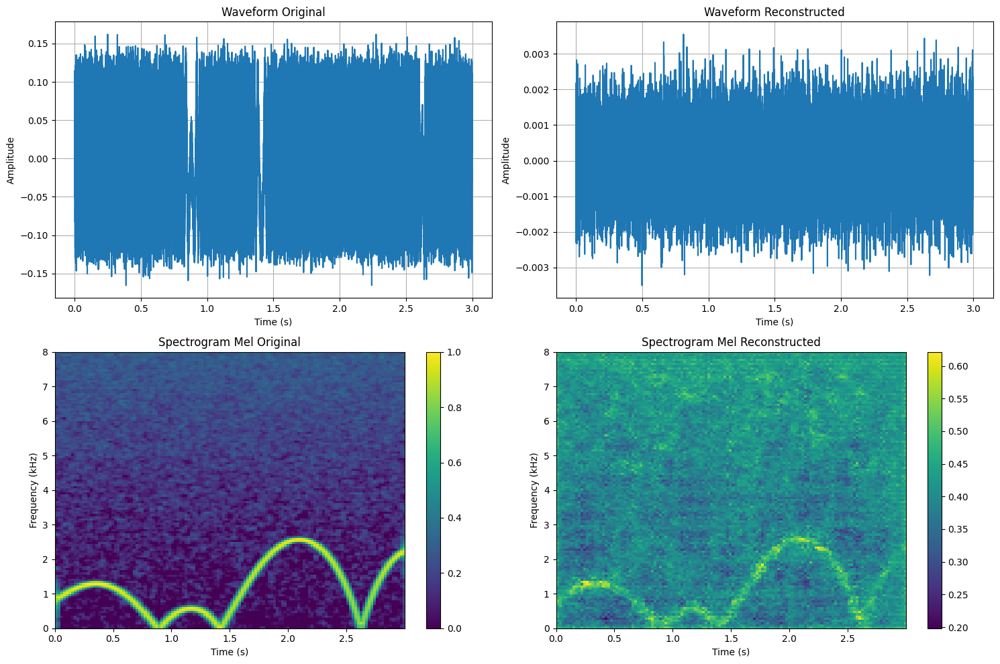

Reconstructed audio saved: reconstructed_audio/epoch_50.wav
Playing original audio...


Playing reconstructed audio...


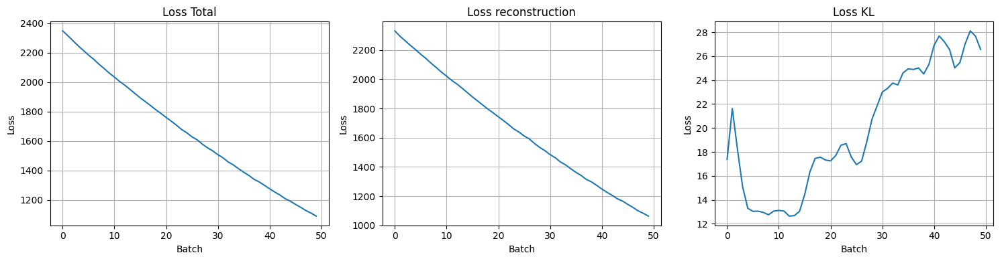

Epoch 51/100


Epoch 51: 100%|██████████| 1/1 [00:00<00:00,  2.11it/s, Loss=1073.2238, Recon=1047.1073, KL=26.1165]


Summary of epochs 51:
Loss total: 1073.2238
Loss reconstruction: 1047.1073
Loss KL: 26.1165
Epoch 52/100


Epoch 52: 100%|██████████| 1/1 [00:00<00:00,  3.95it/s, Loss=1049.6886, Recon=1021.9186, KL=27.7701]


Summary of epochs 52:
Loss total: 1049.6886
Loss reconstruction: 1021.9186
Loss KL: 27.7701
Epoch 53/100


Epoch 53: 100%|██████████| 1/1 [00:00<00:00,  4.01it/s, Loss=1034.1353, Recon=1006.1533, KL=27.9820]


Summary of epochs 53:
Loss total: 1034.1353
Loss reconstruction: 1006.1533
Loss KL: 27.9820
Epoch 54/100


Epoch 54: 100%|██████████| 1/1 [00:00<00:00,  3.30it/s, Loss=1018.3908, Recon=990.5771, KL=27.8137]


Summary of epochs 54:
Loss total: 1018.3908
Loss reconstruction: 990.5771
Loss KL: 27.8137
Epoch 55/100


Epoch 55: 100%|██████████| 1/1 [00:00<00:00,  3.42it/s, Loss=998.8006, Recon=970.3124, KL=28.4882]


Summary of epochs 55:
Loss total: 998.8006
Loss reconstruction: 970.3124
Loss KL: 28.4882
Checkpoint saved: audio_checkpoints/vae_epoch_55.pth
Demonstrate reconstruction...


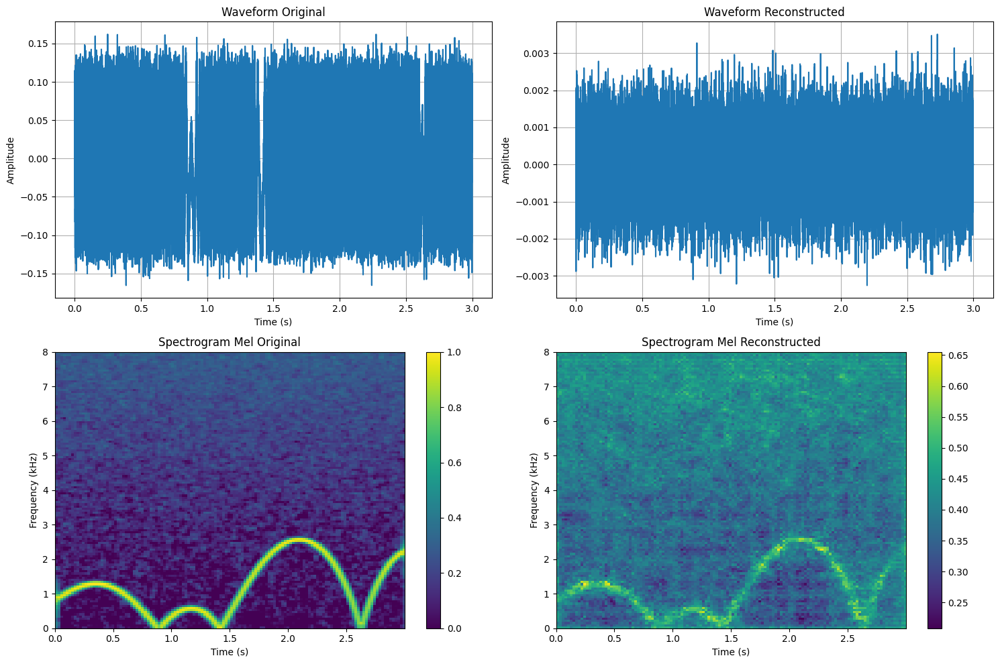

Reconstructed audio saved: reconstructed_audio/epoch_55.wav
Playing original audio...


Playing reconstructed audio...


Epoch 56/100


Epoch 56: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s, Loss=981.5670, Recon=951.5346, KL=30.0324]


Summary of epochs 56:
Loss total: 981.5670
Loss reconstruction: 951.5346
Loss KL: 30.0324
Epoch 57/100


Epoch 57: 100%|██████████| 1/1 [00:00<00:00,  3.43it/s, Loss=962.7377, Recon=932.9066, KL=29.8312]


Summary of epochs 57:
Loss total: 962.7377
Loss reconstruction: 932.9066
Loss KL: 29.8312
Epoch 58/100


Epoch 58: 100%|██████████| 1/1 [00:00<00:00,  3.02it/s, Loss=946.0736, Recon=917.8618, KL=28.2119]


Summary of epochs 58:
Loss total: 946.0736
Loss reconstruction: 917.8618
Loss KL: 28.2119
Epoch 59/100


Epoch 59: 100%|██████████| 1/1 [00:00<00:00,  4.14it/s, Loss=929.7443, Recon=902.4379, KL=27.3064]


Summary of epochs 59:
Loss total: 929.7443
Loss reconstruction: 902.4379
Loss KL: 27.3064
Epoch 60/100


Epoch 60: 100%|██████████| 1/1 [00:00<00:00,  3.89it/s, Loss=908.0989, Recon=879.3937, KL=28.7052]


Summary of epochs 60:
Loss total: 908.0989
Loss reconstruction: 879.3937
Loss KL: 28.7052
Checkpoint saved: audio_checkpoints/vae_epoch_60.pth
Demonstrate reconstruction...


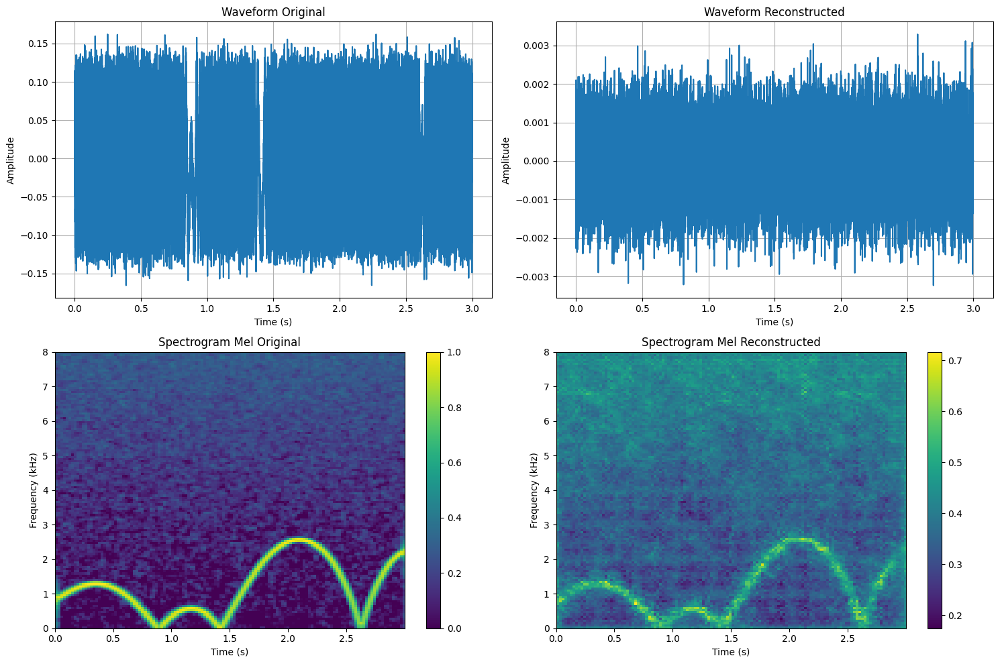

Reconstructed audio saved: reconstructed_audio/epoch_60.wav
Playing original audio...


Playing reconstructed audio...


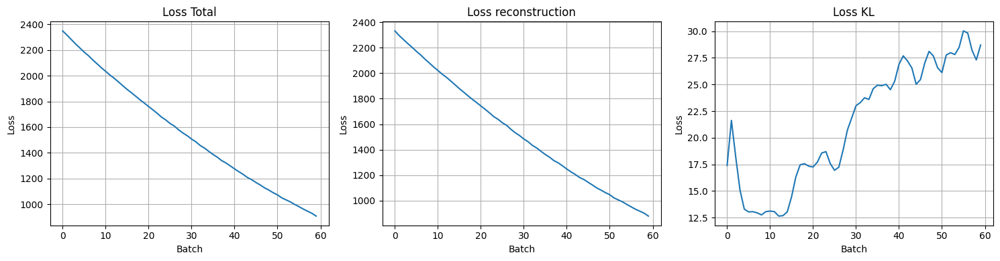

Epoch 61/100


Epoch 61: 100%|██████████| 1/1 [00:00<00:00,  2.82it/s, Loss=891.2755, Recon=863.0244, KL=28.2511]


Summary of epochs 61:
Loss total: 891.2755
Loss reconstruction: 863.0244
Loss KL: 28.2511
Epoch 62/100


Epoch 62: 100%|██████████| 1/1 [00:00<00:00,  3.82it/s, Loss=879.2662, Recon=852.7029, KL=26.5633]


Summary of epochs 62:
Loss total: 879.2662
Loss reconstruction: 852.7029
Loss KL: 26.5633
Epoch 63/100


Epoch 63: 100%|██████████| 1/1 [00:00<00:00,  4.00it/s, Loss=861.5034, Recon=833.2579, KL=28.2455]


Summary of epochs 63:
Loss total: 861.5034
Loss reconstruction: 833.2579
Loss KL: 28.2455
Epoch 64/100


Epoch 64: 100%|██████████| 1/1 [00:00<00:00,  4.09it/s, Loss=848.9852, Recon=818.7929, KL=30.1923]


Summary of epochs 64:
Loss total: 848.9852
Loss reconstruction: 818.7929
Loss KL: 30.1923
Epoch 65/100


Epoch 65: 100%|██████████| 1/1 [00:00<00:00,  3.94it/s, Loss=833.1962, Recon=800.6292, KL=32.5670]


Summary of epochs 65:
Loss total: 833.1962
Loss reconstruction: 800.6292
Loss KL: 32.5670
Checkpoint saved: audio_checkpoints/vae_epoch_65.pth
Demonstrate reconstruction...


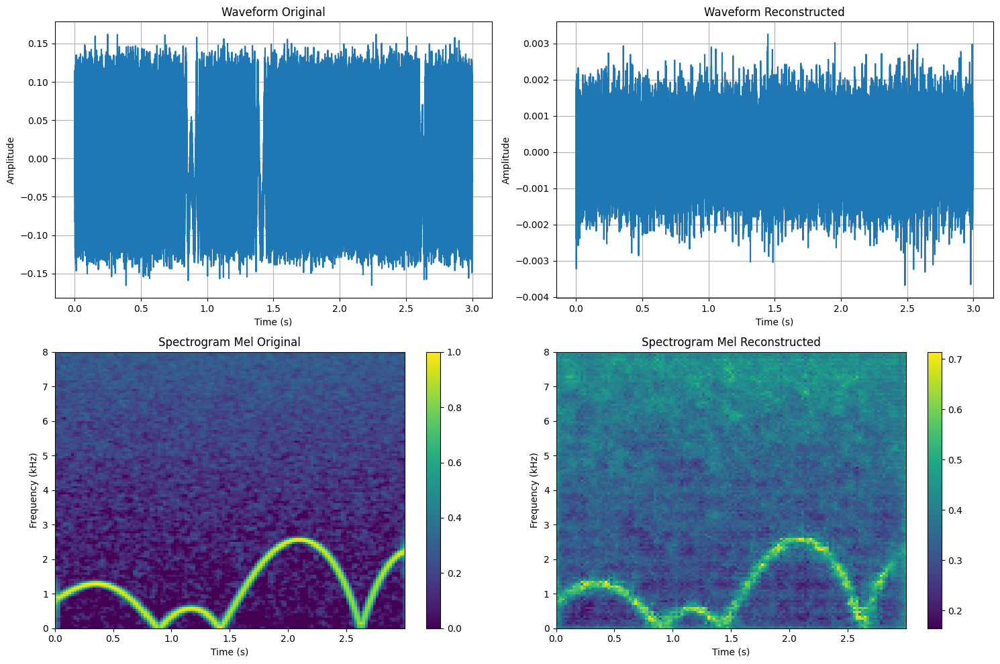

Reconstructed audio saved: reconstructed_audio/epoch_65.wav
Playing original audio...


Playing reconstructed audio...


Epoch 66/100


Epoch 66: 100%|██████████| 1/1 [00:00<00:00,  1.45it/s, Loss=817.8935, Recon=784.9840, KL=32.9095]


Summary of epochs 66:
Loss total: 817.8935
Loss reconstruction: 784.9840
Loss KL: 32.9095
Epoch 67/100


Epoch 67: 100%|██████████| 1/1 [00:00<00:00,  1.60it/s, Loss=801.8767, Recon=770.0515, KL=31.8252]


Summary of epochs 67:
Loss total: 801.8767
Loss reconstruction: 770.0515
Loss KL: 31.8252
Epoch 68/100


Epoch 68: 100%|██████████| 1/1 [00:00<00:00,  3.01it/s, Loss=786.1400, Recon=757.4760, KL=28.6640]


Summary of epochs 68:
Loss total: 786.1400
Loss reconstruction: 757.4760
Loss KL: 28.6640
Epoch 69/100


Epoch 69: 100%|██████████| 1/1 [00:00<00:00,  1.99it/s, Loss=775.3714, Recon=748.8935, KL=26.4779]


Summary of epochs 69:
Loss total: 775.3714
Loss reconstruction: 748.8935
Loss KL: 26.4779
Epoch 70/100


Epoch 70: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s, Loss=756.7070, Recon=727.3840, KL=29.3231]


Summary of epochs 70:
Loss total: 756.7070
Loss reconstruction: 727.3840
Loss KL: 29.3231
Checkpoint saved: audio_checkpoints/vae_epoch_70.pth
Demonstrate reconstruction...


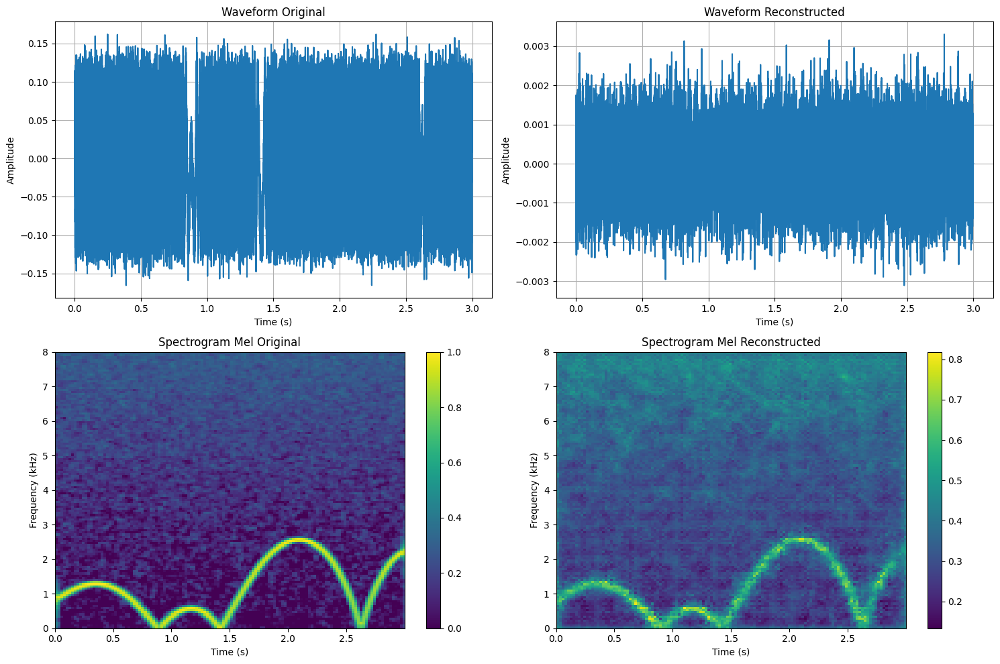

Reconstructed audio saved: reconstructed_audio/epoch_70.wav
Playing original audio...


Playing reconstructed audio...


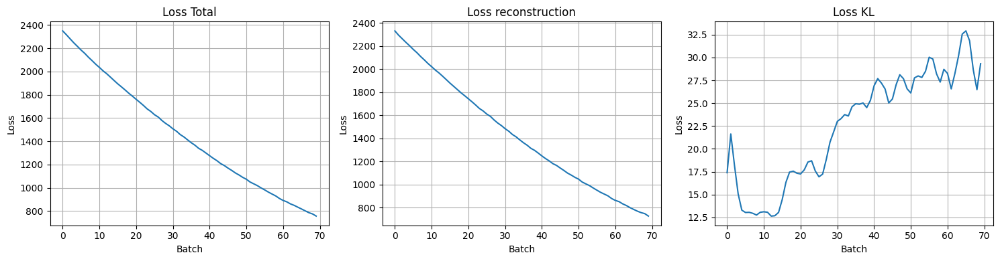

Epoch 71/100


Epoch 71: 100%|██████████| 1/1 [00:00<00:00,  2.10it/s, Loss=743.7537, Recon=712.1279, KL=31.6259]


Summary of epochs 71:
Loss total: 743.7537
Loss reconstruction: 712.1279
Loss KL: 31.6259
Epoch 72/100


Epoch 72: 100%|██████████| 1/1 [00:00<00:00,  3.88it/s, Loss=725.9462, Recon=693.7363, KL=32.2098]


Summary of epochs 72:
Loss total: 725.9462
Loss reconstruction: 693.7363
Loss KL: 32.2098
Epoch 73/100


Epoch 73: 100%|██████████| 1/1 [00:00<00:00,  3.77it/s, Loss=716.7459, Recon=688.5102, KL=28.2357]


Summary of epochs 73:
Loss total: 716.7459
Loss reconstruction: 688.5102
Loss KL: 28.2357
Epoch 74/100


Epoch 74: 100%|██████████| 1/1 [00:00<00:00,  4.03it/s, Loss=707.5569, Recon=682.0589, KL=25.4980]


Summary of epochs 74:
Loss total: 707.5569
Loss reconstruction: 682.0589
Loss KL: 25.4980
Epoch 75/100


Epoch 75: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s, Loss=698.0968, Recon=670.9047, KL=27.1922]


Summary of epochs 75:
Loss total: 698.0968
Loss reconstruction: 670.9047
Loss KL: 27.1922
Checkpoint saved: audio_checkpoints/vae_epoch_75.pth
Demonstrate reconstruction...


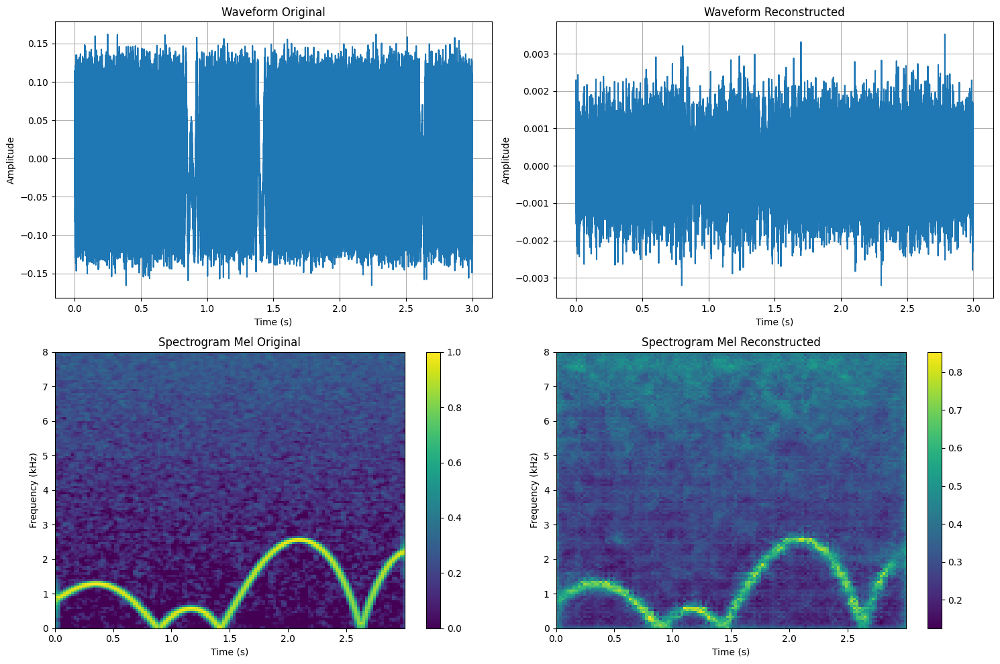

Reconstructed audio saved: reconstructed_audio/epoch_75.wav
Playing original audio...


Playing reconstructed audio...


Epoch 76/100


Epoch 76: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s, Loss=680.5148, Recon=647.8489, KL=32.6659]


Summary of epochs 76:
Loss total: 680.5148
Loss reconstruction: 647.8489
Loss KL: 32.6659
Epoch 77/100


Epoch 77: 100%|██████████| 1/1 [00:00<00:00,  3.13it/s, Loss=668.1926, Recon=633.4536, KL=34.7391]


Summary of epochs 77:
Loss total: 668.1926
Loss reconstruction: 633.4536
Loss KL: 34.7391
Epoch 78/100


Epoch 78: 100%|██████████| 1/1 [00:00<00:00,  3.81it/s, Loss=658.5453, Recon=625.3566, KL=33.1887]


Summary of epochs 78:
Loss total: 658.5453
Loss reconstruction: 625.3566
Loss KL: 33.1887
Epoch 79/100


Epoch 79: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s, Loss=642.4979, Recon=612.7740, KL=29.7240]


Summary of epochs 79:
Loss total: 642.4979
Loss reconstruction: 612.7740
Loss KL: 29.7240
Epoch 80/100


Epoch 80: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s, Loss=635.0862, Recon=609.2001, KL=25.8861]


Summary of epochs 80:
Loss total: 635.0862
Loss reconstruction: 609.2001
Loss KL: 25.8861
Checkpoint saved: audio_checkpoints/vae_epoch_80.pth
Demonstrate reconstruction...


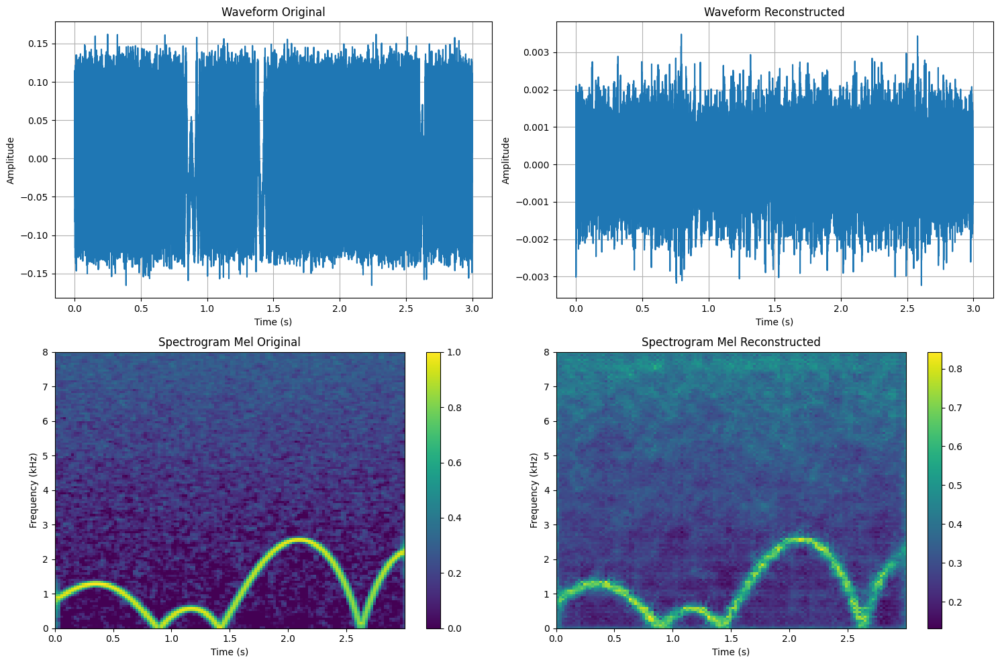

Reconstructed audio saved: reconstructed_audio/epoch_80.wav
Playing original audio...


Playing reconstructed audio...


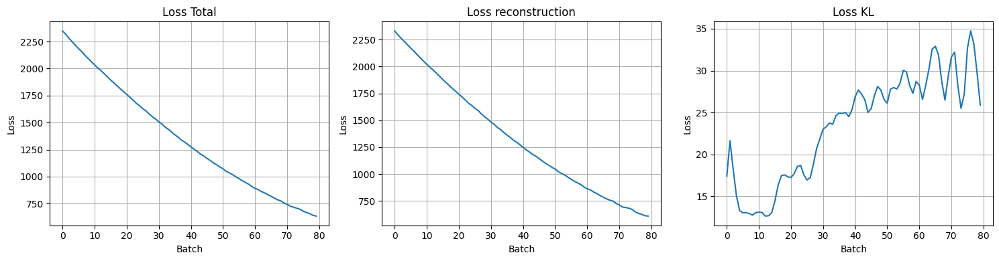

Epoch 81/100


Epoch 81: 100%|██████████| 1/1 [00:00<00:00,  2.51it/s, Loss=620.2394, Recon=591.8740, KL=28.3654]


Summary of epochs 81:
Loss total: 620.2394
Loss reconstruction: 591.8740
Loss KL: 28.3654
Epoch 82/100


Epoch 82: 100%|██████████| 1/1 [00:00<00:00,  3.82it/s, Loss=612.1550, Recon=580.6037, KL=31.5513]


Summary of epochs 82:
Loss total: 612.1550
Loss reconstruction: 580.6037
Loss KL: 31.5513
Epoch 83/100


Epoch 83: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s, Loss=600.7716, Recon=567.3760, KL=33.3955]


Summary of epochs 83:
Loss total: 600.7716
Loss reconstruction: 567.3760
Loss KL: 33.3955
Epoch 84/100


Epoch 84: 100%|██████████| 1/1 [00:00<00:00,  3.84it/s, Loss=587.2549, Recon=554.8407, KL=32.4142]


Summary of epochs 84:
Loss total: 587.2549
Loss reconstruction: 554.8407
Loss KL: 32.4142
Epoch 85/100


Epoch 85: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s, Loss=581.4670, Recon=552.9008, KL=28.5662]


Summary of epochs 85:
Loss total: 581.4670
Loss reconstruction: 552.9008
Loss KL: 28.5662
Checkpoint saved: audio_checkpoints/vae_epoch_85.pth
Demonstrate reconstruction...


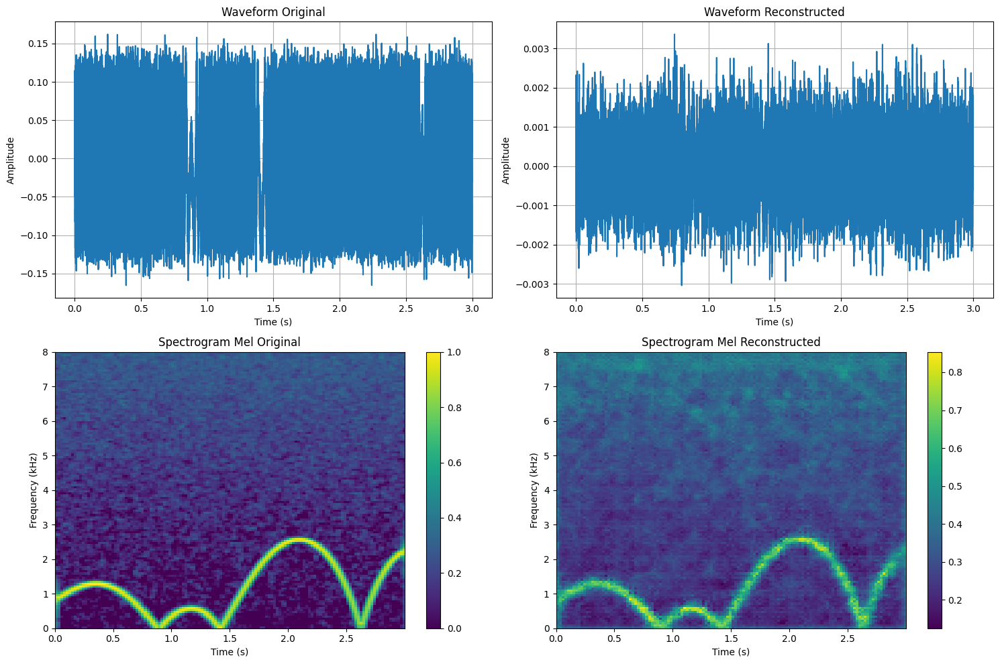

Reconstructed audio saved: reconstructed_audio/epoch_85.wav
Playing original audio...


Playing reconstructed audio...


Epoch 86/100


Epoch 86: 100%|██████████| 1/1 [00:00<00:00,  2.36it/s, Loss=575.2547, Recon=547.9777, KL=27.2770]


Summary of epochs 86:
Loss total: 575.2547
Loss reconstruction: 547.9777
Loss KL: 27.2770
Epoch 87/100


Epoch 87: 100%|██████████| 1/1 [00:00<00:00,  3.91it/s, Loss=558.5788, Recon=528.3135, KL=30.2653]


Summary of epochs 87:
Loss total: 558.5788
Loss reconstruction: 528.3135
Loss KL: 30.2653
Epoch 88/100


Epoch 88: 100%|██████████| 1/1 [00:00<00:00,  3.38it/s, Loss=547.8231, Recon=515.3065, KL=32.5165]


Summary of epochs 88:
Loss total: 547.8231
Loss reconstruction: 515.3065
Loss KL: 32.5165
Epoch 89/100


Epoch 89: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s, Loss=535.8886, Recon=503.9834, KL=31.9052]


Summary of epochs 89:
Loss total: 535.8886
Loss reconstruction: 503.9834
Loss KL: 31.9052
Epoch 90/100


Epoch 90: 100%|██████████| 1/1 [00:00<00:00,  3.82it/s, Loss=526.8212, Recon=499.2854, KL=27.5358]


Summary of epochs 90:
Loss total: 526.8212
Loss reconstruction: 499.2854
Loss KL: 27.5358
Checkpoint saved: audio_checkpoints/vae_epoch_90.pth
Demonstrate reconstruction...


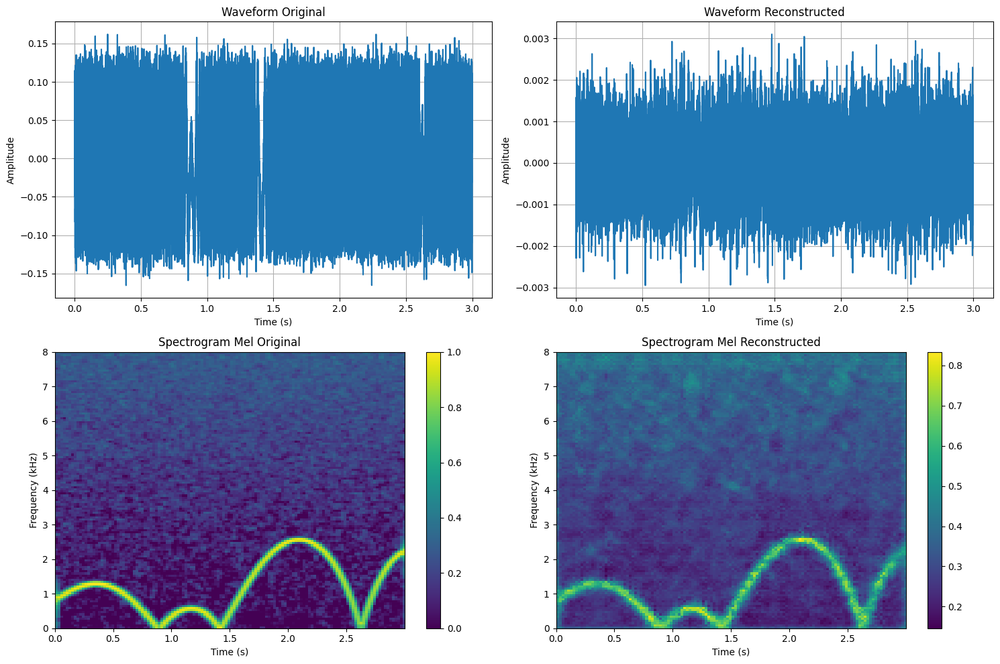

Reconstructed audio saved: reconstructed_audio/epoch_90.wav
Playing original audio...


Playing reconstructed audio...


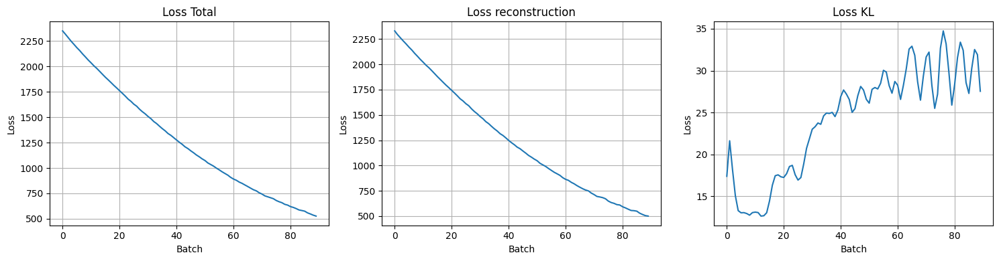

Epoch 91/100


Epoch 91: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s, Loss=518.5283, Recon=494.6824, KL=23.8459]


Summary of epochs 91:
Loss total: 518.5283
Loss reconstruction: 494.6824
Loss KL: 23.8459
Epoch 92/100


Epoch 92: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s, Loss=512.0261, Recon=487.3830, KL=24.6431]


Summary of epochs 92:
Loss total: 512.0261
Loss reconstruction: 487.3830
Loss KL: 24.6431
Epoch 93/100


Epoch 93: 100%|██████████| 1/1 [00:00<00:00,  3.76it/s, Loss=500.8259, Recon=471.7928, KL=29.0332]


Summary of epochs 93:
Loss total: 500.8259
Loss reconstruction: 471.7928
Loss KL: 29.0332
Epoch 94/100


Epoch 94: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s, Loss=490.8508, Recon=458.6554, KL=32.1954]


Summary of epochs 94:
Loss total: 490.8508
Loss reconstruction: 458.6554
Loss KL: 32.1954
Epoch 95/100


Epoch 95: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s, Loss=482.7990, Recon=452.8599, KL=29.9391]


Summary of epochs 95:
Loss total: 482.7990
Loss reconstruction: 452.8599
Loss KL: 29.9391
Checkpoint saved: audio_checkpoints/vae_epoch_95.pth
Demonstrate reconstruction...


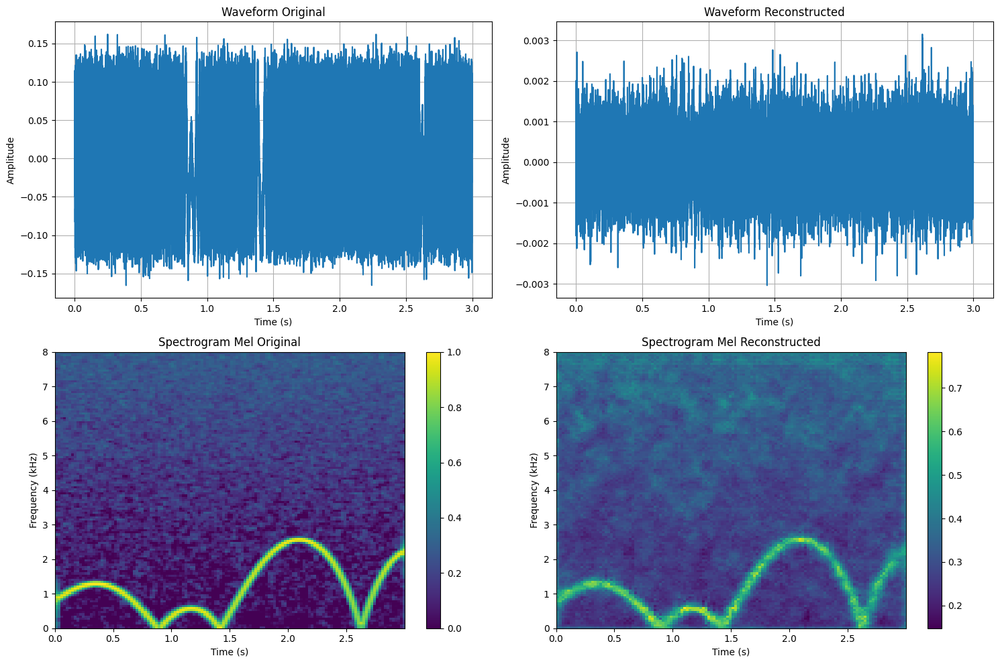

Reconstructed audio saved: reconstructed_audio/epoch_95.wav
Playing original audio...


Playing reconstructed audio...


Epoch 96/100


Epoch 96: 100%|██████████| 1/1 [00:00<00:00,  2.29it/s, Loss=476.1410, Recon=450.9508, KL=25.1901]


Summary of epochs 96:
Loss total: 476.1410
Loss reconstruction: 450.9508
Loss KL: 25.1901
Epoch 97/100


Epoch 97: 100%|██████████| 1/1 [00:00<00:00,  4.02it/s, Loss=467.3422, Recon=443.5842, KL=23.7580]


Summary of epochs 97:
Loss total: 467.3422
Loss reconstruction: 443.5842
Loss KL: 23.7580
Epoch 98/100


Epoch 98: 100%|██████████| 1/1 [00:00<00:00,  3.44it/s, Loss=462.2542, Recon=436.6423, KL=25.6119]


Summary of epochs 98:
Loss total: 462.2542
Loss reconstruction: 436.6423
Loss KL: 25.6119
Epoch 99/100


Epoch 99: 100%|██████████| 1/1 [00:00<00:00,  2.59it/s, Loss=453.2317, Recon=423.9105, KL=29.3213]


Summary of epochs 99:
Loss total: 453.2317
Loss reconstruction: 423.9105
Loss KL: 29.3213
Epoch 100/100


Epoch 100: 100%|██████████| 1/1 [00:00<00:00,  3.49it/s, Loss=450.7407, Recon=419.3292, KL=31.4115]


Summary of epochs 100:
Loss total: 450.7407
Loss reconstruction: 419.3292
Loss KL: 31.4115
Checkpoint saved: audio_checkpoints/vae_epoch_100.pth
Demonstrate reconstruction...


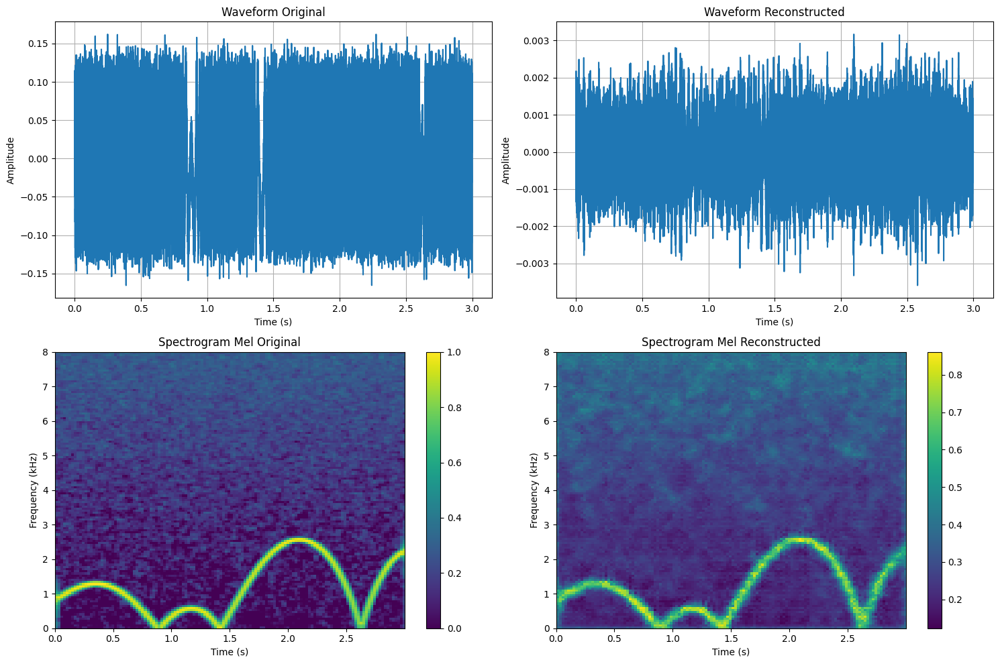

Reconstructed audio saved: reconstructed_audio/epoch_100.wav
Playing original audio...


Playing reconstructed audio...


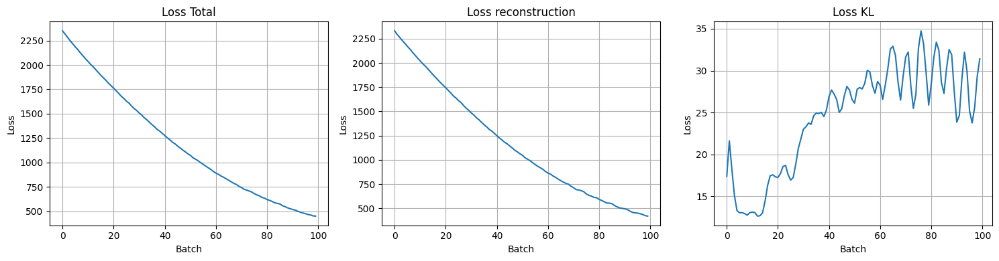

Training completed!


In [81]:
# Training loop
print("Starting AudioVAE training...")
print(f"Epochs: {num_epochs}")
print(f"Batch size: {train_loader.batch_size}")
print(f"Latent dim: {latent_dim}")
print(f"Device: {device}")

for epoch in range(start_epoch, num_epochs):
    print(f"{'='*60}")
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"{'='*60}")
    
    # Treinar uma época
    avg_loss, avg_recon, avg_kl = trainer.train_epoch(train_loader, epoch + 1)
    
    print(f"Summary of epochs {epoch+1}:")
    print(f"Loss total: {avg_loss:.4f}")
    print(f"Loss reconstruction: {avg_recon:.4f}")
    print(f"Loss KL: {avg_kl:.4f}")
    
    # Save checkpoint every 5 seasons
    if (epoch + 1) % 5 == 0:
        trainer.save_checkpoint(epoch + 1, f'audio_checkpoints/vae_epoch_{epoch+1}.pth')
        
        # Demonstrate reconstruction
        print("Demonstrate reconstruction...")
        test_sample = test_batch[0].to(device)
        audio_recon, mel_recon = trainer.reconstruct_audio(
            test_sample,
            save_path=f'reconstructed_audio/epoch_{epoch+1}.wav'
        )
        
        # Play audio
        print("Playing original audio...")
        display(Audio(test_sample.squeeze().cpu().numpy(), rate=22050))
        
        print("Playing reconstructed audio...")
        display(Audio(audio_recon.squeeze().cpu().numpy(), rate=22050))
    
    # Plot progress every 10 epochs
    if (epoch + 1) % 10 == 0 and len(trainer.train_losses) > 0:
        fig, axes = plt.subplots(1, 3, figsize=(15, 4))
        
        axes[0].plot(trainer.train_losses)
        axes[0].set_title('Loss Total')
        axes[0].set_xlabel('Batch')
        axes[0].set_ylabel('Loss')
        axes[0].grid(True)
        
        axes[1].plot(trainer.recon_losses)
        axes[1].set_title('Loss reconstruction')
        axes[1].set_xlabel('Batch')
        axes[1].set_ylabel('Loss')
        axes[1].grid(True)
        
        axes[2].plot(trainer.kl_losses)
        axes[2].set_title('Loss KL')
        axes[2].set_xlabel('Batch')
        axes[2].set_ylabel('Loss')
        axes[2].grid(True)
        
        plt.tight_layout()
        plt.savefig('audio_results/training_progress.png', dpi=150)
        plt.show()

print("Training completed!")

## 6. Quality metrics (MSE, SDR)

We be implemented metrics to evaluate the quality of the reconstruction:
1. MSE (Mean Squared Error) in the time domain
2. SDR (Signal-to-Distortion Ratio)

In [82]:
# Implementation of quality metrics
class AudioMetrics:
    """Calculates quality metrics for reconstructed audio"""
    
    @staticmethod
    def calculate_mse(original, reconstructed):
        """Mean Squared Error"""
        return np.mean((original - reconstructed) ** 2)
    
    @staticmethod
    def calculate_sdr(original, reconstructed, epsilon=1e-8):
        """
        Signal-to-Distortion Ratio
        SDR = 10 * log10(||original||^2 / ||original - reconstructed||^2)
        """
        # Guarantee even length
        min_len = min(len(original), len(reconstructed))
        original = original[:min_len]
        reconstructed = reconstructed[:min_len]
        
        signal_power = np.sum(original ** 2)
        distortion_power = np.sum((original - reconstructed) ** 2)
        
        if distortion_power < epsilon:
            return float('inf')
        
        sdr = 10 * np.log10(signal_power / distortion_power)
        return sdr
    
    @staticmethod
    def calculate_snr(original, reconstructed, epsilon=1e-8):
        """Signal-to-Noise Ratio"""
        min_len = min(len(original), len(reconstructed))
        original = original[:min_len]
        reconstructed = reconstructed[:min_len]
        
        signal_power = np.sum(original ** 2)
        noise_power = np.sum((original - reconstructed) ** 2)
        
        if noise_power < epsilon:
            return float('inf')
        
        snr = 10 * np.log10(signal_power / noise_power)
        return snr
    
    @staticmethod
    def calculate_spectral_convergence(original_spec, reconstructed_spec):
        """Spectral convergence (dB difference)"""
        sc = np.linalg.norm(np.abs(original_spec) - np.abs(reconstructed_spec)) / \
             np.linalg.norm(np.abs(original_spec))
        return sc
    
    @staticmethod
    def evaluate_reconstruction(original_audio, reconstructed_audio, 
                               original_spec=None, reconstructed_spec=None, 
                               sr=22050):
        """Calculates all metrics for given audio samples"""
        metrics = {}
        
        # Time domain metrics
        metrics['mse'] = AudioMetrics.calculate_mse(original_audio, reconstructed_audio)
        metrics['sdr'] = AudioMetrics.calculate_sdr(original_audio, reconstructed_audio)
        metrics['snr'] = AudioMetrics.calculate_snr(original_audio, reconstructed_audio)
        
        # Frequency domain metrics (if spectrograms provided)
        if original_spec is not None and reconstructed_spec is not None:
            metrics['spectral_convergence'] = AudioMetrics.calculate_spectral_convergence(
                original_spec, reconstructed_spec
            )
            
            # Spectral distance
            spectral_distance = np.mean((original_spec - reconstructed_spec) ** 2)
            metrics['spectral_mse'] = spectral_distance
        
        return metrics
    
    @staticmethod
    def visualize_metrics_comparison(metrics_list, epoch_list):
        """Visualize the evolution of metrics throughout the training"""
        fig, axes = plt.subplots(2, 2, figsize=(12, 8))
        
        # Extract metrics
        mse_vals = [m['mse'] for m in metrics_list]
        sdr_vals = [m['sdr'] for m in metrics_list]
        
        # Plot MSE
        axes[0, 0].plot(epoch_list, mse_vals, marker='o')
        axes[0, 0].set_xlabel('Epoch')
        axes[0, 0].set_ylabel('MSE')
        axes[0, 0].set_title('MSE vs Epoch')
        axes[0, 0].grid(True)
        
        # Plot SDR
        axes[0, 1].plot(epoch_list, sdr_vals, marker='o', color='orange')
        axes[0, 1].set_xlabel('Epoch')
        axes[0, 1].set_ylabel('SDR (dB)')
        axes[0, 1].set_title('SDR vs Epoch')
        axes[0, 1].grid(True)
        
        # Plot SNR if available
        if 'snr' in metrics_list[0]:
            snr_vals = [m['snr'] for m in metrics_list]
            axes[1, 0].plot(epoch_list, snr_vals, marker='o', color='green')
            axes[1, 0].set_xlabel('Epoch')
            axes[1, 0].set_ylabel('SNR (dB)')
            axes[1, 0].set_title('SNR vs Epoch')
            axes[1, 0].grid(True)
        
        # Plot spectral convergence if available
        if 'spectral_convergence' in metrics_list[0]:
            sc_vals = [m['spectral_convergence'] for m in metrics_list]
            axes[1, 1].plot(epoch_list, sc_vals, marker='o', color='red')
            axes[1, 1].set_xlabel('Epoch')
            axes[1, 1].set_ylabel('Spectral Convergence')
            axes[1, 1].set_title('Spectral Convergence vs Epoch')
            axes[1, 1].grid(True)
        
        plt.tight_layout()
        plt.savefig('audio_results/metrics_evolution.png', dpi=150)
        plt.show()

Assessing reconstruction quality...
Loading best checkpoint: audio_checkpoints/vae_epoch_100.pth
Checkpoint loaded: audio_checkpoints/vae_epoch_100.pth
Calculating metrics on 10 samples...
EVALUATION RESULTS
MSE: 0.0050
SDR: -0.0009
SNR: -0.0009
SPECTRAL_CONVERGENCE: 0.6088
SPECTRAL_MSE: 0.0215


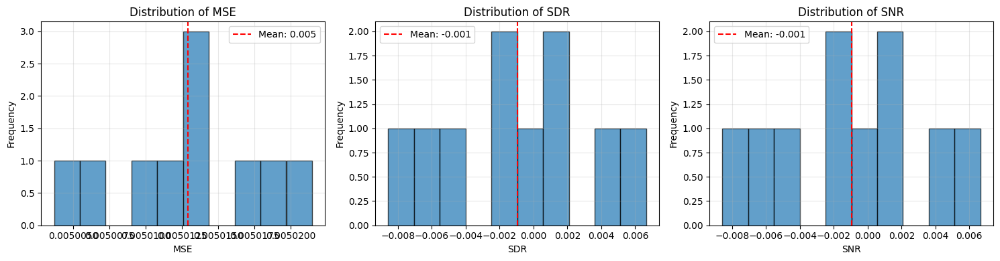

In [83]:
# Evaluate trained model
print("Assessing reconstruction quality...")

# Load better checkpoint
checkpoint_files = glob.glob('audio_checkpoints/vae_epoch_*.pth')
if checkpoint_files:
    best_checkpoint = max(checkpoint_files, key=os.path.getctime)
    print(f"Loading best checkpoint: {best_checkpoint}")
    trainer.load_checkpoint(best_checkpoint)

# Evaluate on a test set
def evaluate_model(trainer, test_samples=10):
    """Evaluate the model on several samples"""
    model.eval()
    
    all_metrics = []
    
    with torch.no_grad():
        for i in range(min(test_samples, len(train_dataset))):
            # Take a sample
            audio_original = train_dataset[i].to(device)
            
            # Convert to Mel spectrogram
            mel_original = audio_processor.audio_to_mel(audio_original.unsqueeze(0))
            
            # Rebuild
            mel_recon, _, _ = model(mel_original)
            
            # Convert back to audio
            audio_recon = audio_processor.mel_to_audio(mel_recon)
            
            # Convert to numpy
            audio_orig_np = audio_original.squeeze().cpu().numpy()
            audio_recon_np = audio_recon.squeeze().cpu().numpy()
            mel_orig_np = mel_original.squeeze().cpu().numpy()
            mel_recon_np = mel_recon.squeeze().cpu().numpy()

            min_len = min(len(audio_orig_np), len(audio_recon_np))
            audio_orig_np = audio_orig_np[:min_len]
            audio_recon_np = audio_recon_np[:min_len]
            
            # Calculate metrics
            metrics = AudioMetrics.evaluate_reconstruction(
                audio_orig_np, audio_recon_np, mel_orig_np, mel_recon_np
            )
            
            all_metrics.append(metrics)
            
            # Save reconstructed audio
            if i < 3:  # Save only the first 3 for inspection
                sf.write(f'reconstructed_audio/sample_{i}_original.wav', 
                        audio_orig_np, 22050)
                sf.write(f'reconstructed_audio/sample_{i}_reconstructed.wav', 
                        audio_recon_np, 22050)
    
    model.train()
    
    # Calculate averages
    avg_metrics = {}
    for key in all_metrics[0].keys():
        avg_metrics[key] = np.mean([m[key] for m in all_metrics])
    
    return avg_metrics, all_metrics

# Perform evaluation
print("Calculating metrics on 10 samples...")
avg_metrics, all_metrics = evaluate_model(trainer, test_samples=10)

print("" + "="*60)
print("EVALUATION RESULTS")
print("="*60)
for metric_name, value in avg_metrics.items():
    print(f"{metric_name.upper()}: {value:.4f}")

# View distribution of metrics
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

metrics_to_plot = ['mse', 'sdr', 'snr'] if 'snr' in avg_metrics else ['mse', 'sdr']
for idx, metric in enumerate(metrics_to_plot):
    values = [m[metric] for m in all_metrics]
    axes[idx].hist(values, bins=10, alpha=0.7, edgecolor='black')
    axes[idx].set_xlabel(metric.upper())
    axes[idx].set_ylabel('Frequency')
    axes[idx].set_title(f'Distribution of {metric.upper()}')
    axes[idx].axvline(np.mean(values), color='red', linestyle='--', 
                     label=f'Mean: {np.mean(values):.3f}')
    axes[idx].legend()
    axes[idx].grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('audio_results/metrics_distribution.png', dpi=150)
plt.show()

## 7. Audio reconstruction and evaluation

VAE allows to generate new audio from latent space.

In [100]:
# New audio generation
class AudioGenerator:
    """Interface for generating and manipulating audio with VAE"""
    def __init__(self, model, audio_processor, device):
        self.model = model
        self.audio_processor = audio_processor
        self.device = device
        self.model.eval()
    
    def generate_from_latent(self, z=None, num_samples=1):
        """Generates audio from latent space"""
        if z is None:
            z = torch.randn(num_samples, model.latent_dim).to(self.device)
        
        with torch.no_grad():
            mel_generated = model.decode(z)
            audio_generated = self.audio_processor.mel_to_audio(mel_generated)
        
        return audio_generated, mel_generated
    
    def interpolate_latent_space(self, z1=None, z2=None, num_steps=10):
        """Interpolate between two points in latent space"""
        if z1 is None:
            z1 = torch.randn(1, model.latent_dim).to(self.device)
        if z2 is None:
            z2 = torch.randn(1, model.latent_dim).to(self.device)
        
        audios = []
        mels = []
        
        with torch.no_grad():
            for alpha in np.linspace(0, 1, num_steps):
                z = alpha * z1 + (1 - alpha) * z2
                mel = model.decode(z)
                audio = self.audio_processor.mel_to_audio(mel)
                
                audios.append(audio.squeeze().cpu().numpy())
                mels.append(mel.squeeze().cpu().numpy())
        
        # Concatenate audio files for continuous playback
        audio_interp = np.concatenate(audios)
        
        # Visualize interpolation
        self._visualize_interpolation(audios, mels, num_steps)
        
        return audio_interp, audios, mels
    
    def _visualize_interpolation(self, audios, mels, num_steps):
        """Visualize interpolation in latent space"""
        fig, axes = plt.subplots(2, 1, figsize=(15, 8))
        
        # Plot concatenated waveforms
        audio_concat = np.concatenate(audios)
        time = np.arange(len(audio_concat)) / self.audio_processor.sr
        
        axes[0].plot(time, audio_concat)
        axes[0].set_xlabel('Time (s)')
        axes[0].set_ylabel('Amplitude')
        axes[0].set_title('Interpolation in Latent Space (Waveform)')
        axes[0].grid(True)

        # Plot spectrograms
        mel_concat = np.concatenate(mels, axis=1)
        extent = [0, time[-1], 0, self.audio_processor.fmax/1000]
        
        im = axes[1].imshow(mel_concat, aspect='auto', origin='lower', extent=extent)
        axes[1].set_xlabel('Time (s)')
        axes[1].set_ylabel('Frequency (kHz)')
        axes[1].set_title('Interpolation in Latent Space (Spectrogram)')
        plt.colorbar(im, ax=axes[1])
        
        # Add dividing lines
        for i in range(1, num_steps):
            x_pos = i * len(audios[0]) / self.audio_processor.sr
            axes[0].axvline(x=x_pos, color='r', linestyle='--', alpha=0.5)
            axes[1].axvline(x=x_pos, color='r', linestyle='--', alpha=0.5)
        
        plt.tight_layout()
        plt.savefig('audio_results/latent_interpolation.png', dpi=150)
        plt.show()
    
    def generate_and_save(self, num_samples=5, output_dir='generated_audio'):
        """Generates and saves new audio samples"""
        os.makedirs(output_dir, exist_ok=True)

        print(f"Generating {num_samples} new audio samples...")

        for i in range(num_samples):
            audio, mel = self.generate_from_latent(num_samples=1)
            audio_np = audio.squeeze().cpu().numpy()

            # Save audio
            output_path = os.path.join(output_dir, f'generated_{i}.wav')
            sf.write(output_path, audio_np, self.audio_processor.sr)
            
            # Save spectrogram
            mel_np = mel.squeeze().cpu().numpy()
            plt.figure(figsize=(10, 4))
            plt.imshow(mel_np, aspect='auto', origin='lower')
            plt.title(f'Generated Audio {i}')
            plt.colorbar()
            plt.savefig(os.path.join(output_dir, f'generated_{i}_spec.png'), dpi=150)
            plt.close()
            
            print(f"  Sample {i} saved: {output_path}")
        
        print(f"All generated audio samples saved to: {output_dir}")

# Initialize generator
generator = AudioGenerator(model, audio_processor, device)

GENERATION DEMONSTRATION OF AUDIO
1. Generating random audio...
Playing randomly generated audio...


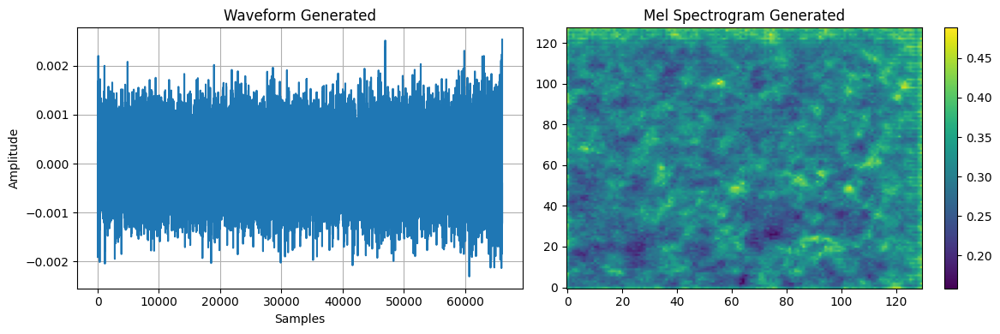

2. Demonstrating interpolation in latent space...


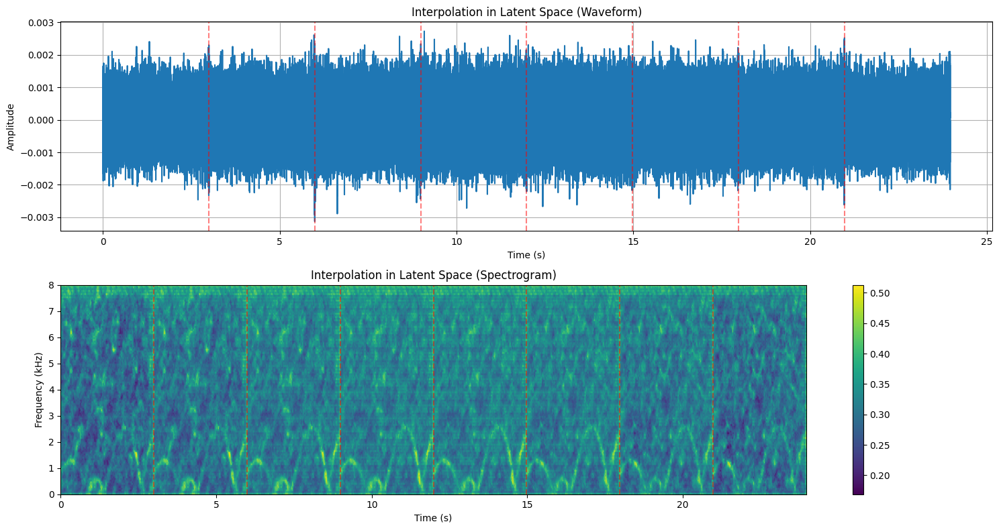

Playing interpolation...


3. Generating and saving 3 new audios...
Generating 3 new audio samples...
  Sample 0 saved: generated_audio/generated_0.wav
  Sample 1 saved: generated_audio/generated_1.wav
  Sample 2 saved: generated_audio/generated_2.wav
All generated audio samples saved to: generated_audio


In [101]:
# Generation demonstration
print("GENERATION DEMONSTRATION OF AUDIO")
print("="*40)

# 1. Generate random audio
print("1. Generating random audio...")
audio_random, mel_random = generator.generate_from_latent(num_samples=1)

print("Playing randomly generated audio...")
display(Audio(audio_random.squeeze().cpu().numpy(), rate=22050))

# Visualize
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(audio_random.squeeze().cpu().numpy())
plt.title('Waveform Generated')
plt.xlabel('Samples')
plt.ylabel('Amplitude')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.imshow(mel_random.squeeze().cpu().numpy(), aspect='auto', origin='lower')
plt.title('Mel Spectrogram Generated')
plt.colorbar()
plt.tight_layout()
plt.show()

# 2. Interpolation in latent space
print("2. Demonstrating interpolation in latent space...")
audio_interp, audios_list, mels_list = generator.interpolate_latent_space(num_steps=8)

print("Playing interpolation...")
display(Audio(audio_interp, rate=22050))

# 3. Generate and save multiple audios
print("3. Generating and saving 3 new audios...")
generator.generate_and_save(num_samples=3, output_dir='generated_audio')


## 8. Interface for inference

In [102]:
# Command-line interface
class AudioVAECLI:
    """Command-line interface for audio VAE model"""
    def __init__(self, model_path=None):
        self.device = device
        
        # Load model
        if model_path is None:
            # Find latest checkpoint
            checkpoint_files = glob.glob('audio_checkpoints/vae_epoch_*.pth')
            if checkpoint_files:
                model_path = max(checkpoint_files, key=os.path.getctime)
            else:
                print("No checkpoint found!")
                return
        
        print(f"Loading model: {model_path}")
        
        # Load model
        self.model = AudioVAE(latent_dim=latent_dim).to(device)
        checkpoint = torch.load(model_path, map_location=device)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.model.eval()
        
        # Initialize processor
        self.audio_processor = AudioProcessor()
        
        print("Model loaded successfully!")
    
    def reconstruct_audio_file(self, audio_path, output_path=None):
        """Reconstructs an audio file"""
        # Load audio
        audio, sr = sf.read(audio_path)
        
        # Resample if necessary
        if sr != 22050:
            audio = librosa.resample(audio, orig_sr=sr, target_sr=22050)
            sr = 22050
        
        # Convert to tensor
        audio_tensor = torch.FloatTensor(audio).unsqueeze(0).unsqueeze(0).to(device)
        
        # Reconstruct
        with torch.no_grad():
            mel_original = self.audio_processor.audio_to_mel(audio_tensor)
            mel_reconstructed, _, _ = self.model(mel_original)
            audio_reconstructed = self.audio_processor.mel_to_audio(mel_reconstructed)
        
        # Convert to numpy
        audio_recon_np = audio_reconstructed.squeeze().cpu().numpy()
        
        # Save if specified
        if output_path:
            sf.write(output_path, audio_recon_np, sr)
            print(f"Reconstructed audio saved in: {output_path}")
        
        return audio_recon_np
    
    def generate_random_audio(self, duration=3.0, output_path=None):
        """Generates random audio"""
        sr = 22050
        num_samples = int(sr * duration)
        
        with torch.no_grad():
            # Generate random latent point
            z = torch.randn(1, latent_dim).to(device)
            
            # Decode
            mel_generated = self.model.decode(z)
            audio_generated = self.audio_processor.mel_to_audio(mel_generated)
        
        # Adjust duration
        audio_np = audio_generated.squeeze().cpu().numpy()
        if len(audio_np) > num_samples:
            audio_np = audio_np[:num_samples]
        elif len(audio_np) < num_samples:
            audio_np = np.pad(audio_np, (0, num_samples - len(audio_np)))
        
        # Save if specified
        if output_path:
            sf.write(output_path, audio_np, sr)
            print(f"Generated audio saved in: {output_path}")
        
        return audio_np
    
    def batch_reconstruct(self, input_dir, output_dir):
        """Reconstructs all audios in a directory"""
        os.makedirs(output_dir, exist_ok=True)
        
        audio_files = glob.glob(os.path.join(input_dir, '*.wav')) + \
                     glob.glob(os.path.join(input_dir, '*.mp3'))
        
        print(f"Processing {len(audio_files)} files...")
        
        for i, audio_file in enumerate(audio_files):
            try:
                output_file = os.path.join(output_dir, 
                                          f'reconstructed_{os.path.basename(audio_file)}')
                self.reconstruct_audio_file(audio_file, output_file)
                print(f"  [{i+1}/{len(audio_files)}] Processed: {os.path.basename(audio_file)}")
            except Exception as e:
                print(f"  Error processing {audio_file}: {e}")
        
        print(f"All processed audios saved in: {output_dir}")

In [103]:
# CLI demonstration
print("CLI demonstration")
print("-" * 40)

cli = AudioVAECLI()

# 1. Generate random audio
print("1. Generate random audio of 3 seconds...")
random_audio = cli.generate_random_audio(duration=3.0, 
                                        output_path='generated_audio/cli_generated.wav')

print("Playing generated audio...")
display(Audio(random_audio, rate=22050))

# 2. If there are test files, demonstrate reconstruction
test_files = glob.glob('audio_data/examples/*.wav')
if test_files:
    print(f"2. Reconstructing test file: {test_files[0]}")
    reconstructed = cli.reconstruct_audio_file(
        test_files[0],
        output_path='generated_audio/cli_reconstructed.wav'
    )

    print("Playing original vs reconstructed...")
    print("Original:")
    display(Audio(test_files[0]))

    print("Reconstructed:")
    display(Audio(reconstructed, rate=22050))
else:
    print("2. No test files found for reconstruction")

CLI demonstration
----------------------------------------
Loading model: audio_checkpoints/vae_epoch_100.pth
Model loaded successfully!
1. Generate random audio of 3 seconds...
Generated audio saved in: generated_audio/cli_generated.wav
Playing generated audio...


2. No test files found for reconstruction


## 9. Final Saving and Metadata

In [106]:
# Saving the final model
def save_final_audio_model(model, trainer, metrics, epoch):
    """Save the final model and all the information, correcting the JIT trace error."""
    final_dir = 'final_audio_model'
    os.makedirs(final_dir, exist_ok=True)
    
    # 1. Salvar modelo completo (State Dict)
    model_path = os.path.join(final_dir, 'audio_vae_final.pth')
    torch.save({
        'model_state_dict': model.state_dict(),
        'latent_dim': latent_dim,
        'epoch': epoch,
        'metrics': metrics
    }, model_path)
    
    # 2. Save traced model for quick inference
    model.eval()
    example_input = torch.randn(1, latent_dim).to(device)
    
    class DecoderWrapper(torch.nn.Module):
        def __init__(self, decode_func):
            super().__init__()
            self.decode = decode_func
        def forward(self, x):
            return self.decode(x)
    decoder_module = DecoderWrapper(model.decode)
    
    try:
        traced_model = torch.jit.trace(decoder_module, example_input)
        traced_model.save(os.path.join(final_dir, 'audio_vae_traced.pt'))
    except Exception as e:
        print(f"Aviso: Erro ao gerar Traced Model: {e}")
    
    # 3. Save audio processor configuration
    processor_info = {
        'sr': audio_processor.sr,
        'n_fft': audio_processor.n_fft,
        'hop_length': audio_processor.hop_length,
        'n_mels': audio_processor.n_mels,
        'fmax': audio_processor.fmax
    }
    
    import json
    with open(os.path.join(final_dir, 'audio_processor_config.json'), 'w') as f:
        json.dump(processor_info, f, indent=2)
    
    # 4. Saving metrics (Handling NumPy types to JSON)
    def json_serializable(obj):
        if isinstance(obj, (np.float32, np.float64)):
            return float(obj)
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return obj

    training_history = {
        'train_losses': [float(x) for x in trainer.train_losses],
        'recon_losses': [float(x) for x in trainer.recon_losses],
        'kl_losses': [float(x) for x in trainer.kl_losses],
        'evaluation_metrics': metrics
    }
    
    with open(os.path.join(final_dir, 'training_history.json'), 'w') as f:
        json.dump(training_history, f, indent=2, default=json_serializable)
    
    print(f"Final model saved in: {final_dir}")
    print(f"- PyTorch Model: {os.path.join(final_dir, 'audio_vae_final.pth')}")
    print(f"- Traced Model: {os.path.join(final_dir, 'audio_vae_traced.pt')}")
    print(f"- Configuration: {os.path.join(final_dir, 'audio_processor_config.json')}")
    print(f"- History: {os.path.join(final_dir, 'training_history.json')}")
    print(f"- Example usage: {os.path.join(final_dir, 'example_usage.py')}")

# Saving the final model
print("Saving final model...")
save_final_audio_model(model, trainer, avg_metrics, num_epochs)


Saving final model...
Aviso: Erro ao gerar Traced Model: Cannot insert a Tensor that requires grad as a constant. Consider making it a parameter or input, or detaching the gradient
Tensor:
Columns 1 to 6-8.1376e-02  2.9582e-02 -8.2090e-02 -2.8135e-02 -6.1656e-02  2.2945e-02
-5.8958e-02 -3.6623e-02  1.8387e-02 -2.6391e-02 -8.7767e-02  6.0569e-02
 8.7843e-02 -3.3240e-02 -2.8127e-02 -4.1892e-02  6.2062e-02 -7.9990e-02
 6.2887e-03 -4.6534e-02  7.6982e-03 -4.5288e-02  4.0566e-02 -4.3421e-02
 2.6068e-02  7.1763e-02 -5.4507e-02  7.0672e-02 -8.3218e-02 -6.5349e-02
-5.6137e-02 -1.1417e-02  3.5585e-03  4.8720e-02 -3.2343e-02 -1.7841e-02
-1.0277e-02  1.8501e-02 -6.1201e-02  2.2401e-02  5.5399e-02  1.6032e-02
 9.0828e-03 -7.7931e-02 -7.4125e-02 -7.1049e-02  4.7033e-02  1.2459e-02
-6.6201e-02  7.5800e-02 -5.1322e-02 -8.6814e-03 -3.4898e-02  1.2817e-02
 4.4138e-02  6.7526e-02 -3.4575e-03 -7.2382e-03  1.9014e-02  6.5873e-02
 2.6985e-02  1.6186e-02 -2.5796e-02  7.4125e-03 -2.6849e-02 -5.2331e-02
 8.55

## 10. Instructions for Execution

```python
# To run this notebook:

# 1. Install the dependencies (run the first cell)
# 2. The dataset will be downloaded automatically on the first run
# 3. Run all cells sequentially
# 4. Training may take several hours (reduce num_epochs for testing)
# 5. Use the CLI to generate/reconstruct audio after training

# To use the trained model:
import torch
import soundfile as sf
 
# Load model
model = AudioVAE(latent_dim=128)
model.load_state_dict(torch.load('final_audio_model/audio_vae_final.pth'))
model.eval()

# Generate new audio
z = torch.randn(1, 128)
with torch.no_grad():
    mel_spec = model.decode(z)
    # Convert mel_spec to audio using AudioProcessor

# Reconstruct existing audio
audio = load_audio('input.wav')
mel = audio_processor.audio_to_mel(audio)
reconstructed_mel, _, _ = model(mel)
reconstructed_audio = audio_processor.mel_to_audio(reconstructed_mel)
```

In [108]:
print("Summary:")
print(f"- Dataset: {'MUSDB18 (vocals)' if os.path.exists('./audio_data/musdb18') else 'Synthetic examples'}")
print(f"- Model: VAE with latent dimension {latent_dim}")
print(f"- Training epochs: {num_epochs}")
print(f"- Final metrics: MSE={avg_metrics.get('mse', 0):.4f}, SDR={avg_metrics.get('sdr', 0):.4f} dB")
print(f"- Checkpoints saved in: audio_checkpoints/")
print(f"- Generated audio in: generated_audio/")
print(f"- Final model in: final_audio_model/")

Summary:
- Dataset: Synthetic examples
- Model: VAE with latent dimension 128
- Training epochs: 100
- Final metrics: MSE=0.0050, SDR=-0.0009 dB
- Checkpoints saved in: audio_checkpoints/
- Generated audio in: generated_audio/
- Final model in: final_audio_model/
